In [1]:
import statsmodels.api as sm
from statsmodels.formula.api import ols
import random

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
from scipy import stats
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import train_test_split
import math
import sklearn.model_selection as ms
import sklearn.metrics as sklm

sns.set_style('whitegrid')
warnings.simplefilter(action='ignore')

# sklearn preprocessing for dealing with categorical variables
from sklearn.preprocessing import LabelEncoder

In [2]:
pd.options.display.max_columns = None
pd.options.display.max_rows = None

app_train = pd.read_csv('application_train.csv')

## Exploratory Data Analysis
###### Exploratory Data Analysis (EDA) is an open-ended process where we calculate statistics and make figures to find trends, anomalies, patterns, or relationships within the data. The goal of EDA is to learn what our data can tell us. It generally starts out with a high level overview, then narrows in to specific areas as we find intriguing areas of the data. The findings may be interesting in their own right, or they can be used to inform our modeling choices, such as by helping us decide which features to use.

### Examine the Distribution of the Target Column
###### The target is what we are asked to predict: either a 0 for the loan was repaid on time, or a 1 indicating the client had payment difficulties. We can first examine the number of loans falling into each category.

In [3]:
app_train['TARGET'].value_counts()

0    282686
1     24825
Name: TARGET, dtype: int64

<AxesSubplot:ylabel='Frequency'>

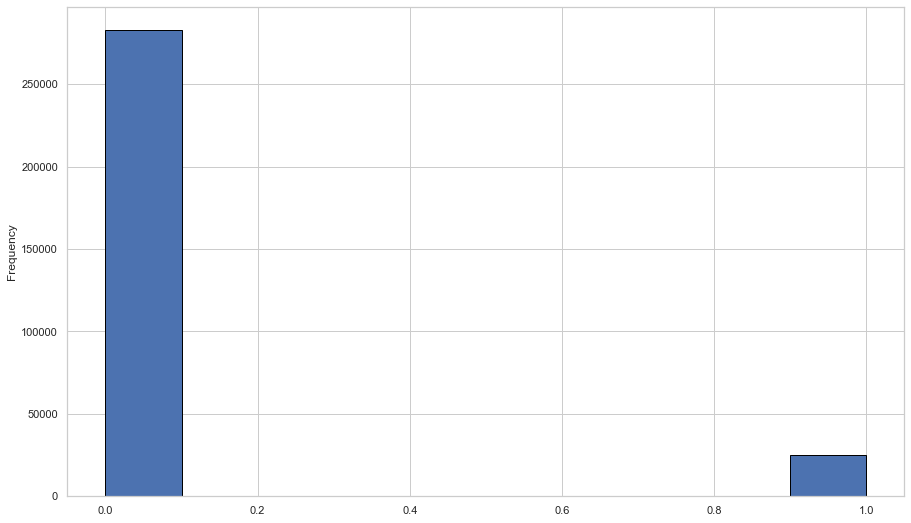

In [4]:
sns.set_theme(style="whitegrid")
f, ax = plt.subplots(figsize = (15,9))
app_train['TARGET'].astype(int).plot.hist(edgecolor = 'black')

### Examine Missing Values
###### Next we can look at the number and percentage of missing values in each column.

In [5]:
# Function to calculate missing values by column# Funct 
def missing_values_table(df):
        # Total missing values
        mis_val = df.isnull().sum()
        
        # Percentage of missing values
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        
        # Make a table with the results
        mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        
        # Rename the columns
        mis_val_table_ren_columns = mis_val_table.rename(
        columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        
        # Sort the table by percentage of missing descending
        mis_val_table_ren_columns = mis_val_table_ren_columns[
            mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        
        # Print some summary information
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns.\n"      
            "There are " + str(mis_val_table_ren_columns.shape[0]) +
              " columns that have missing values.")
        
        # Return the dataframe with missing information
        return mis_val_table_ren_columns

In [6]:
# Missing values statistics
missing_values = missing_values_table(app_train)
missing_values.head(20)

Your selected dataframe has 122 columns.
There are 67 columns that have missing values.


,Missing Values,% of Total Values
COMMONAREA_MEDI,214865,69.9
COMMONAREA_AVG,214865,69.9
COMMONAREA_MODE,214865,69.9
NONLIVINGAPARTMENTS_MEDI,213514,69.4
NONLIVINGAPARTMENTS_MODE,213514,69.4
NONLIVINGAPARTMENTS_AVG,213514,69.4
FONDKAPREMONT_MODE,210295,68.4
LIVINGAPARTMENTS_MODE,210199,68.4
LIVINGAPARTMENTS_MEDI,210199,68.4
LIVINGAPARTMENTS_AVG,210199,68.4


In [7]:
percentage = (app_train.isnull().mean()) * 100
percentage = percentage.sort_values(ascending = False).head(20)

In [8]:
data = {"Index" : [i for i in percentage.index],"Value" : [j for j in percentage.values]}
pd.DataFrame(data)

,Index,Value
0,COMMONAREA_MEDI,69.872297
1,COMMONAREA_AVG,69.872297
2,COMMONAREA_MODE,69.872297
3,NONLIVINGAPARTMENTS_MODE,69.432963
4,NONLIVINGAPARTMENTS_AVG,69.432963
5,NONLIVINGAPARTMENTS_MEDI,69.432963
6,FONDKAPREMONT_MODE,68.386172
7,LIVINGAPARTMENTS_MODE,68.354953
8,LIVINGAPARTMENTS_AVG,68.354953
9,LIVINGAPARTMENTS_MEDI,68.354953


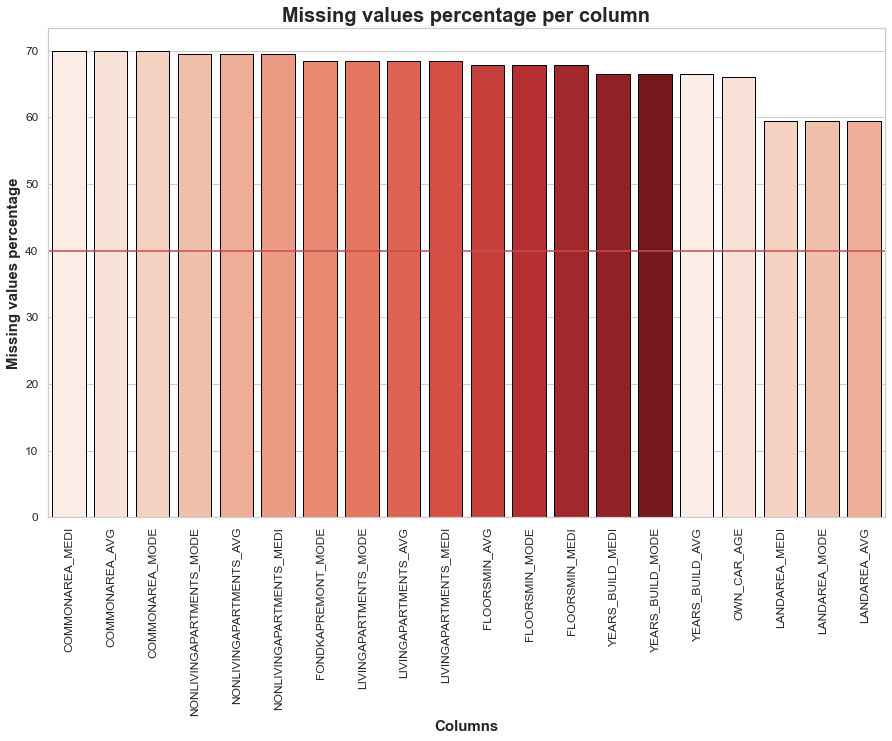

In [9]:
f, ax = plt.subplots(figsize = (15,9))
sns.barplot(x = 'Index', y = 'Value', data = data,
            label = 'Total', palette =  sns.color_palette("Reds", 15), edgecolor = 'black')
plt.axhline(y = 40, color = 'r', linestyle = '-')
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.xticks(rotation=90)
plt.ylabel('Missing values percentage', size=15, weight='bold')
plt.xlabel('Columns', size=15, weight='bold')
plt.title('Missing values percentage per column', fontsize=20, weight='bold' )
plt.show()

### Column Types
###### Let's look at the number of columns of each data type. int64 and float64 are numeric variables (which can be either discrete or continuous). object columns contain strings and are categorical features.

In [10]:
# Number of each type of column
app_train.dtypes.value_counts()

float64    65
int64      41
object     16
dtype: int64

###### Let's now look at the number of unique entries in each of the object (categorical) columns.

In [11]:
# Number of unique classes in each object column
app_train.select_dtypes('object').apply(pd.Series.nunique, axis = 0)

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

###### Most of the categorical variables have a relatively small number of unique entries. We will need to find a way to deal with these categorical variables !

### Label Encoding and One-Hot Encoding
###### Let's implement the policy described above: for any categorical variable (dtype == object) with 2 unique categories, we will use label encoding, and for any categorical variable with more than 2 unique categories, we will use one-hot encoding.
###### For label encoding, we use the Scikit-Learn LabelEncoder and for one-hot encoding, the pandas get_dummies(df) function.

In [12]:
# Create a label encoder object
le = LabelEncoder()
le_count = 0

# Iterate through the columns
for col in app_train:
    if app_train[col].dtype == 'object':
        # If 2 or fewer unique categories
        if len(list(app_train[col].unique())) <= 2:
            # Train on the training data
            le.fit(app_train[col])
            # Transform both training and testing data
            app_train[col] = le.transform(app_train[col])
            
            # Keep track of how many columns were label encoded
            le_count += 1
            
print('%d columns were label encoded.' % le_count)

3 columns were label encoded.


In [13]:
# one-hot encoding of categorical variables
app_train = pd.get_dummies(app_train)

print('Training Features shape: ', app_train.shape)

Training Features shape:  (307511, 243)


### Anomalies

###### One problem we always want to be on the lookout for when doing EDA is anomalies within the data. These may be due to mis-typed numbers, errors in measuring equipment, or they could be valid but extreme measurements. One way to support anomalies quantitatively is by looking at the statistics of a column using the describe method. The numbers in the DAYS_BIRTH column are negative because they are recorded relative to the current loan application. To see these stats in years, we can mutliple by -1 and divide by the number of days in a year:

In [14]:
(app_train['DAYS_BIRTH'] / -365).describe()

count    307511.000000
mean         43.936973
std          11.956133
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

In [15]:
app_train['DAYS_EMPLOYED'].describe()

count    307511.000000
mean      63815.045904
std      141275.766519
min      -17912.000000
25%       -2760.000000
50%       -1213.000000
75%        -289.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64

Text(0.5, 0, 'Days Employment')

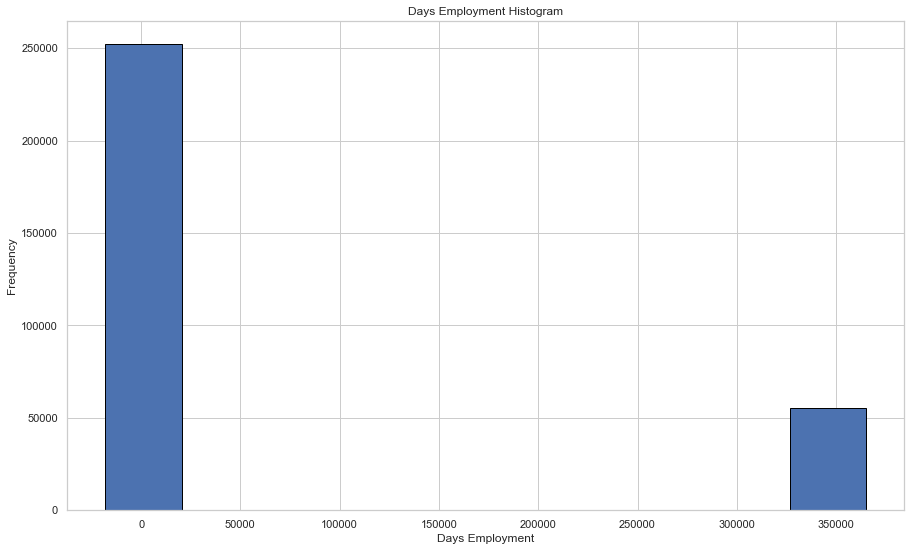

In [16]:
sns.set_theme(style="whitegrid")
f, ax = plt.subplots(figsize = (15,9))
app_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram', edgecolor = 'black')
plt.xlabel('Days Employment')

In [17]:
anom = app_train[app_train['DAYS_EMPLOYED'] == 365243]
non_anom = app_train[app_train['DAYS_EMPLOYED'] != 365243]
print('The non-anomalies default on %0.2f%% of loans' % (100 * non_anom['TARGET'].mean()))
print('The anomalies default on %0.2f%% of loans' % (100 * anom['TARGET'].mean()))
print('There are %d anomalous days of employment' % len(anom))

The non-anomalies default on 8.66% of loans
The anomalies default on 5.40% of loans
There are 55374 anomalous days of employment


Text(0.5, 0, 'Days Employment')

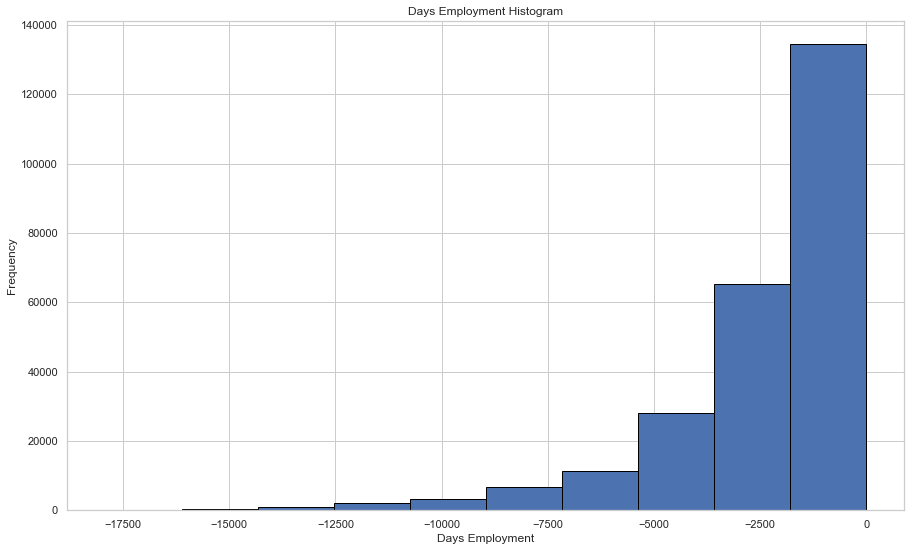

In [18]:
f, ax = plt.subplots(figsize = (15,9))
# Create an anomalous flag column
app_train['DAYS_EMPLOYED_ANOM'] = app_train["DAYS_EMPLOYED"] == 365243

# Replace the anomalous values with nan
app_train['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)

app_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram', edgecolor = 'black');
plt.xlabel('Days Employment')

### Correlations

In [19]:
# Find correlations with the target and sort
correlations = app_train.corr()['TARGET'].sort_values()

In [20]:
# Display correlations
print('Most Positive Correlations:\n', correlations.tail(15))
print('\nMost Negative Correlations:\n', correlations.head(15))

Most Positive Correlations:
 OCCUPATION_TYPE_Laborers                             0.043019
FLAG_DOCUMENT_3                                      0.044346
REG_CITY_NOT_LIVE_CITY                               0.044395
FLAG_EMP_PHONE                                       0.045982
NAME_EDUCATION_TYPE_Secondary / secondary special    0.049824
REG_CITY_NOT_WORK_CITY                               0.050994
DAYS_ID_PUBLISH                                      0.051457
CODE_GENDER_M                                        0.054713
DAYS_LAST_PHONE_CHANGE                               0.055218
NAME_INCOME_TYPE_Working                             0.057481
REGION_RATING_CLIENT                                 0.058899
REGION_RATING_CLIENT_W_CITY                          0.060893
DAYS_EMPLOYED                                        0.074958
DAYS_BIRTH                                           0.078239
TARGET                                               1.000000
Name: TARGET, dtype: float64

Most Negati

In [21]:
correlations_2 = app_train.corr()['TARGET'].sort_values()
correlations_positive_15 = correlations_2.tail(15)

In [22]:
ext_data = app_train[['TARGET', 'OCCUPATION_TYPE_Laborers', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]
ext_data_corrs = ext_data.corr()
ext_data_corrs

,TARGET,OCCUPATION_TYPE_Laborers,EXT_SOURCE_2,EXT_SOURCE_3,DAYS_BIRTH
TARGET,1.000000,0.043019,-0.160472,-0.178919,0.078239
OCCUPATION_TYPE_Laborers,0.043019,1.000000,-0.039105,-0.020891,0.142519
EXT_SOURCE_2,-0.160472,-0.039105,1.000000,0.109167,-0.091996
EXT_SOURCE_3,-0.178919,-0.020891,0.109167,1.000000,-0.205478
DAYS_BIRTH,0.078239,0.142519,-0.091996,-0.205478,1.000000


In [23]:
ext_data = app_train[[i for i in correlations_positive_15.index]]
ext_data_corrs = ext_data.corr()
ext_data_corrs

,OCCUPATION_TYPE_Laborers,FLAG_DOCUMENT_3,REG_CITY_NOT_LIVE_CITY,FLAG_EMP_PHONE,NAME_EDUCATION_TYPE_Secondary / secondary special,REG_CITY_NOT_WORK_CITY,DAYS_ID_PUBLISH,CODE_GENDER_M,DAYS_LAST_PHONE_CHANGE,NAME_INCOME_TYPE_Working,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,DAYS_EMPLOYED,DAYS_BIRTH,TARGET
OCCUPATION_TYPE_Laborers,1.000000,0.078676,0.020013,0.219149,0.132427,0.114263,0.043492,0.235741,0.002242,0.204414,0.011683,0.011690,-0.009049,0.142519,0.043019
FLAG_DOCUMENT_3,0.078676,1.000000,0.003117,0.248534,0.060650,0.056275,0.050309,-0.087258,-0.061760,0.164231,0.062528,0.067083,-0.047286,0.109666,0.044346
REG_CITY_NOT_LIVE_CITY,0.020013,0.003117,1.000000,0.092166,-0.022009,0.440409,0.076326,0.048257,0.054183,0.032899,0.035741,0.045669,0.114101,0.180382,0.044395
FLAG_EMP_PHONE,0.219149,0.248534,0.092166,1.000000,-0.107785,0.256427,0.273611,0.157239,-0.021103,0.484134,-0.032871,-0.034712,0.002268,0.619888,0.045982
NAME_EDUCATION_TYPE_Secondary / secondary special,0.132427,0.060650,-0.022009,-0.107785,1.000000,0.015404,-0.042497,0.004719,-0.004816,0.069859,0.065050,0.067983,-0.031167,-0.157389,0.049824
REG_CITY_NOT_WORK_CITY,0.114263,0.056275,0.440409,0.256427,0.015404,1.000000,0.099354,0.137581,0.046788,0.149716,0.008360,0.028081,0.128797,0.242401,0.050994
DAYS_ID_PUBLISH,0.043492,0.050309,0.076326,0.273611,-0.042497,0.099354,1.000000,0.000132,0.088576,0.128708,-0.005103,-0.007737,0.089869,0.272691,0.051457
CODE_GENDER_M,0.235741,-0.087258,0.048257,0.157239,0.004719,0.137581,0.000132,1.000000,0.025282,0.106282,-0.017885,-0.017288,0.092568,0.148060,0.054713
DAYS_LAST_PHONE_CHANGE,0.002242,-0.061760,0.054183,-0.021103,-0.004816,0.046788,0.088576,0.025282,1.000000,0.007111,0.026022,0.025717,0.141688,0.082939,0.055218
NAME_INCOME_TYPE_Working,0.204414,0.164231,0.032899,0.484134,0.069859,0.149716,0.128708,0.106282,0.007111,1.000000,0.102809,0.093937,0.017315,0.304568,0.057481


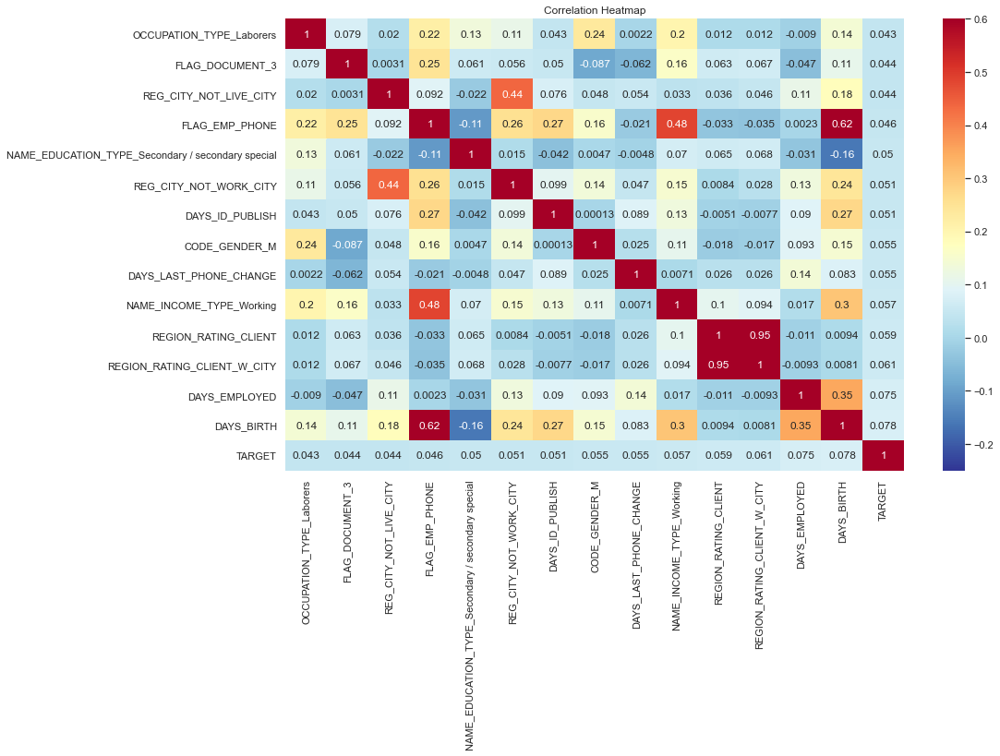

In [24]:
plt.figure(figsize = (15, 9))

# Heatmap of correlations
sns.heatmap(ext_data_corrs, cmap = plt.cm.RdYlBu_r, vmin = -0.25, annot = True, vmax = 0.6)
plt.title('Correlation Heatmap');

###### Let's take a look at some of more significant correlations: the DAYS_BIRTH is the most positive correlation. (except for TARGET because the correlation of a variable with itself is always 1!) Looking at the documentation, DAYS_BIRTH is the age in days of the client at the time of the loan in negative days (for whatever reason!). The correlation is positive, but the value of this feature is actually negative, meaning that as the client gets older, they are less likely to default on their loan (ie the target == 0). That's a little confusing, so we will take the absolute value of the feature and then the correlation will be negative.

### Effect of Age on Repayment

In [29]:
# Find the correlation of the positive days since birth and target
app_train['DAYS_BIRTH'] = abs(app_train['DAYS_BIRTH'])
app_train['DAYS_BIRTH'].corr(app_train['TARGET'])

-0.07823930830982709

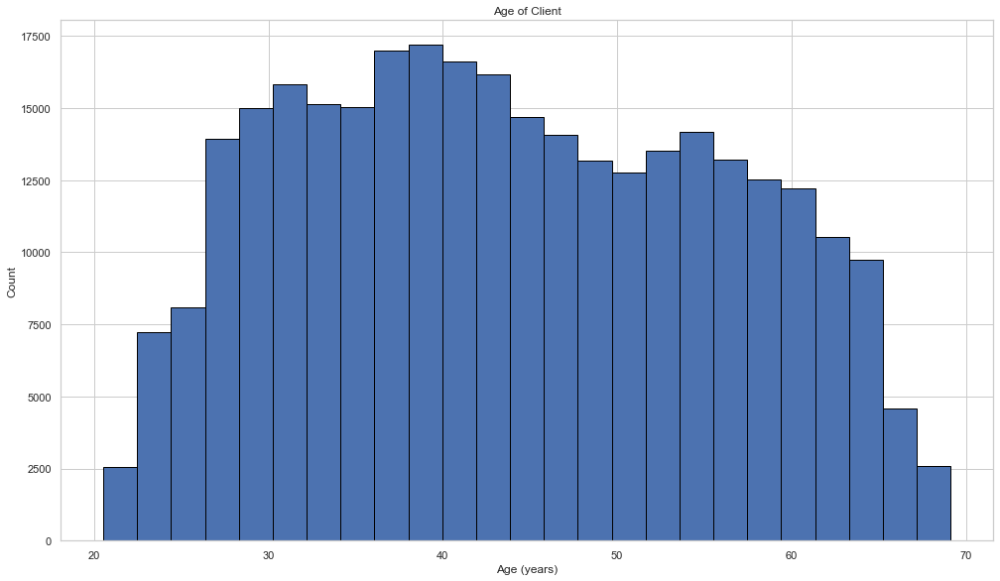

In [30]:
sns.set_theme(style="whitegrid")
plt.figure(figsize = (15, 9))
# Set the style of plots
# plt.style.use('fivethirtyeight')

# Plot the distribution of ages in years
plt.hist(app_train['DAYS_BIRTH'] / 365, edgecolor = 'black', bins = 25)
plt.title('Age of Client'); plt.xlabel('Age (years)'); plt.ylabel('Count');

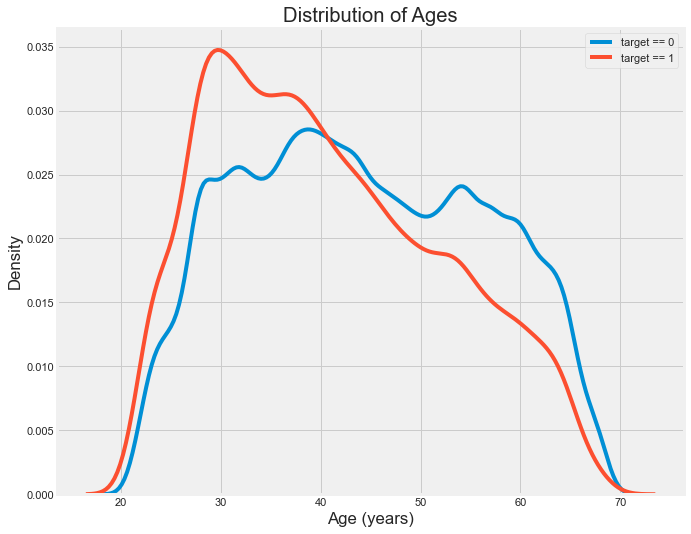

In [31]:
plt.figure(figsize = (10, 8))
plt.style.use('fivethirtyeight')

# KDE plot of loans that were repaid on time
sns.kdeplot(app_train.loc[app_train['TARGET'] == 0, 'DAYS_BIRTH'] / 365, label = 'target == 0')

# KDE plot of loans which were not repaid on time
sns.kdeplot(app_train.loc[app_train['TARGET'] == 1, 'DAYS_BIRTH'] / 365, label = 'target == 1')

# Labeling of plot
plt.xlabel('Age (years)'); plt.ylabel('Density'); plt.title('Distribution of Ages')

plt.legend()

In [32]:
# Age information into a separate dataframe
age_data = app_train[['TARGET', 'DAYS_BIRTH']]
age_data['YEARS_BIRTH'] = age_data['DAYS_BIRTH'] / 365

# Bin the age data
age_data['YEARS_BINNED'] = pd.cut(age_data['YEARS_BIRTH'], bins = np.linspace(20, 70, num = 11))
age_data.head(10)

,TARGET,DAYS_BIRTH,YEARS_BIRTH,YEARS_BINNED
0,1,9461,25.920548,"(25.0, 30.0]"
1,0,16765,45.931507,"(45.0, 50.0]"
2,0,19046,52.180822,"(50.0, 55.0]"
3,0,19005,52.068493,"(50.0, 55.0]"
4,0,19932,54.608219,"(50.0, 55.0]"
5,0,16941,46.413699,"(45.0, 50.0]"
6,0,13778,37.747945,"(35.0, 40.0]"
7,0,18850,51.643836,"(50.0, 55.0]"
8,0,20099,55.065753,"(55.0, 60.0]"
9,0,14469,39.641096,"(35.0, 40.0]"


In [33]:
# Group by the bin and calculate averages
age_groups  = age_data.groupby('YEARS_BINNED').mean()
age_groups

,TARGET,DAYS_BIRTH,YEARS_BIRTH
YEARS_BINNED,,,
"(20.0, 25.0]",0.123036,8532.795625,23.377522
"(25.0, 30.0]",0.111436,10155.219250,27.822518
"(30.0, 35.0]",0.102814,11854.848377,32.479037
"(35.0, 40.0]",0.089414,13707.908253,37.555913
"(40.0, 45.0]",0.078491,15497.661233,42.459346
"(45.0, 50.0]",0.074171,17323.900441,47.462741
"(50.0, 55.0]",0.066968,19196.494791,52.593136
"(55.0, 60.0]",0.055314,20984.262742,57.491131
"(60.0, 65.0]",0.052737,22780.547460,62.412459


Text(0.5, 1.0, 'Failure to Repay by Age Group')

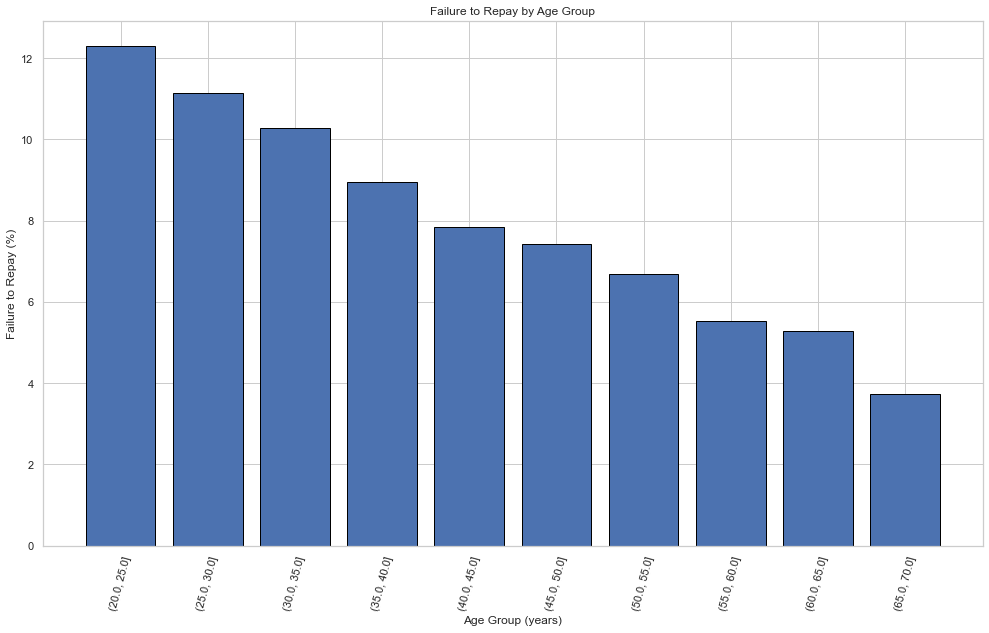

In [34]:
sns.set_theme(style="whitegrid")

plt.figure(figsize = (15, 9))

# Graph the age bins and the average of the target as a bar plot
plt.bar(age_groups.index.astype(str), 100 * age_groups['TARGET'], edgecolor = 'black')

# Plot labeling
plt.xticks(rotation = 75); plt.xlabel('Age Group (years)'); plt.ylabel('Failure to Repay (%)')
plt.title('Failure to Repay by Age Group')

### Exterior Sources

In [35]:
# Extract the EXT_SOURCE variables and show correlations
ext_data = app_train[['TARGET', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]
ext_data_corrs = ext_data.corr()
ext_data_corrs

,TARGET,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,DAYS_BIRTH
TARGET,1.000000,-0.155317,-0.160472,-0.178919,-0.078239
EXT_SOURCE_1,-0.155317,1.000000,0.213982,0.186846,0.600610
EXT_SOURCE_2,-0.160472,0.213982,1.000000,0.109167,0.091996
EXT_SOURCE_3,-0.178919,0.186846,0.109167,1.000000,0.205478
DAYS_BIRTH,-0.078239,0.600610,0.091996,0.205478,1.000000


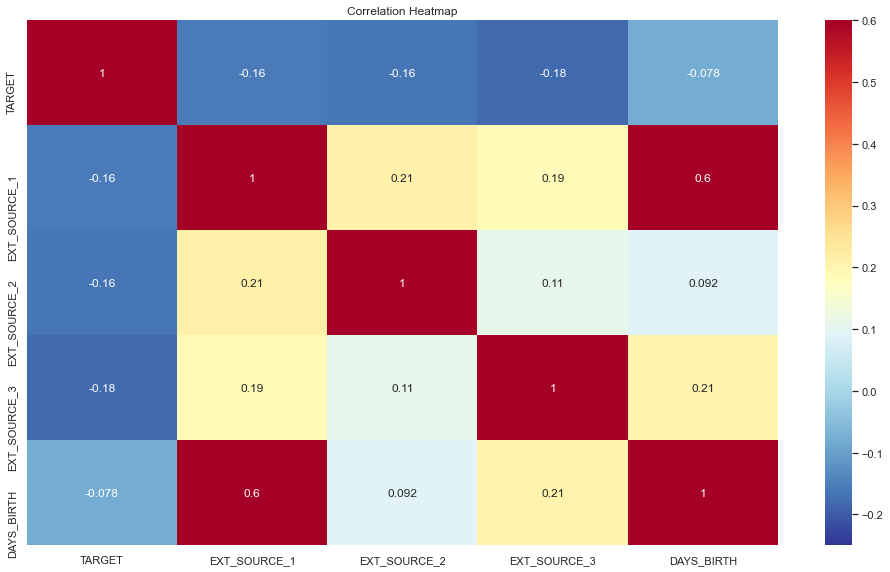

In [36]:
plt.figure(figsize = (15, 9))

# Heatmap of correlations
sns.heatmap(ext_data_corrs, cmap = plt.cm.RdYlBu_r, vmin = -0.25, annot = True, vmax = 0.6)
plt.title('Correlation Heatmap');

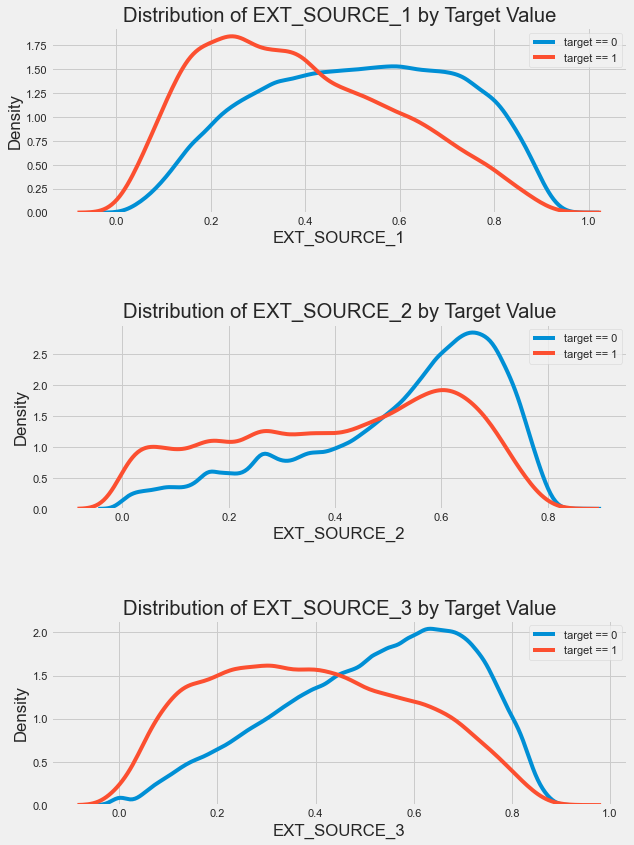

In [37]:
plt.style.use('fivethirtyeight')

plt.figure(figsize = (10, 12))

# iterate through the sources
for i, source in enumerate(['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']):
    
    # create a new subplot for each source
    plt.subplot(3, 1, i + 1)
    # plot repaid loans
    sns.kdeplot(app_train.loc[app_train['TARGET'] == 0, source], label = 'target == 0')
    # plot loans that were not repaid
    sns.kdeplot(app_train.loc[app_train['TARGET'] == 1, source], label = 'target == 1')
    # Label the plots
    plt.title('Distribution of %s by Target Value' % source)
    plt.xlabel('%s' % source); plt.ylabel('Density');
    plt.legend()
    

# set the spacing between subplots
plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=1, 
                    wspace=0.4, 
                    hspace=0.6)

plt.show()

## Feature Engineering

### Domain Knowledge Features

In [38]:
app_train_domain = app_train.copy()

app_train_domain['CREDIT_INCOME_PERCENT'] = app_train_domain['AMT_CREDIT'] / app_train_domain['AMT_INCOME_TOTAL']
app_train_domain['ANNUITY_INCOME_PERCENT'] = app_train_domain['AMT_ANNUITY'] / app_train_domain['AMT_INCOME_TOTAL']
app_train_domain['CREDIT_TERM'] = app_train_domain['AMT_ANNUITY'] / app_train_domain['AMT_CREDIT']
app_train_domain['DAYS_EMPLOYED_PERCENT'] = app_train_domain['DAYS_EMPLOYED'] / app_train_domain['DAYS_BIRTH']

#### Visualize New Variables

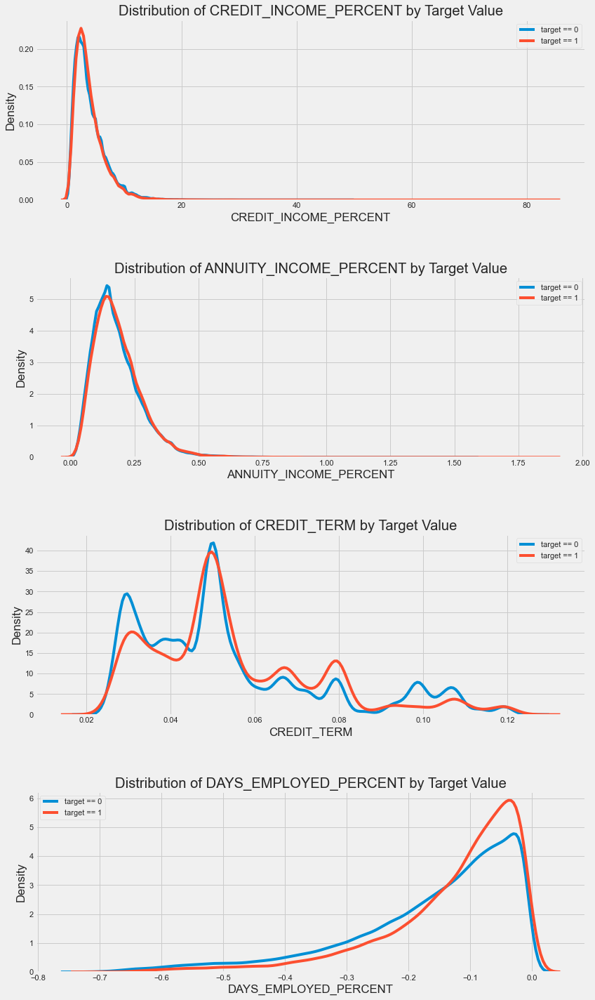

In [39]:
plt.style.use('fivethirtyeight')

plt.figure(figsize = (12, 20))
# iterate through the new features
for i, feature in enumerate(['CREDIT_INCOME_PERCENT', 'ANNUITY_INCOME_PERCENT', 'CREDIT_TERM', 'DAYS_EMPLOYED_PERCENT']):
    
    # create a new subplot for each source
    plt.subplot(4, 1, i + 1)
    # plot repaid loans
    sns.kdeplot(app_train_domain.loc[app_train_domain['TARGET'] == 0, feature], label = 'target == 0')
    # plot loans that were not repaid
    sns.kdeplot(app_train_domain.loc[app_train_domain['TARGET'] == 1, feature], label = 'target == 1')
    
    # Label the plots
    plt.title('Distribution of %s by Target Value' % feature)
    plt.xlabel('%s' % feature); plt.ylabel('Density');
    
    plt.legend()
    
plt.tight_layout(h_pad = 4)

## Customized Metrics

In [40]:
from sklearn.metrics import fbeta_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import make_scorer
from sklearn.metrics import roc_auc_score, roc_curve

In [41]:
def generate_model_report_Beta_3(y_actual, y_predicted):
    print("Accuracy = " , accuracy_score(y_actual, y_predicted))
    print("Precision = " ,precision_score(y_actual, y_predicted))
    print("Recall = " ,recall_score(y_actual, y_predicted))
    print("F1 Score = " ,f1_score(y_actual, y_predicted))
    print("FB Score (Beta = 3) = ",fbeta_score(y_actual, y_predicted, average='binary', beta=3))
    pass

In [42]:
def generate_auc_roc_curve(clf, X_test):
    y_pred_proba = clf.predict_proba(X_test)[:, 1]
    fpr, tpr, thresholds = roc_curve(test_y,  y_pred_proba)
    auc = roc_auc_score(test_y, y_pred_proba)
    plt.plot(fpr,tpr,label="AUC ROC Curve with Area Under the curve ="+str(auc))
    plt.legend(loc=4)
    plt.show()
    pass

In [43]:
F_Beta = make_scorer(fbeta_score, average='binary', beta=3)

## XGBoost Classifier

### UNDERSAMPLING

In [131]:
app_train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business 

In [210]:
app_train.loc[app_train.index==26504,]

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business 

In [211]:
app_train.loc[app_train.index==25486,]

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business 

In [132]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer

# Drop the target from the training data
if 'TARGET' in app_train:
    train = app_train.drop(columns = ['TARGET','SK_ID_CURR'])
else:
    train = app_train.copy()
    
train_target = app_train.loc[:,'TARGET']

train_SK_ID_CURR = app_train.loc[:,'SK_ID_CURR']
    
    
# Median imputation of missing values
imputer = SimpleImputer(missing_values=np.nan, strategy='median')

# Scale each feature to 0-1
scaler = MinMaxScaler(feature_range = (0, 1))

# Fit on the training data
imputer.fit(train)

# Transform training data 
train = imputer.transform(train)

# Repeat with the scaler
scaler.fit(train)
train = scaler.transform(train)

# train = pd.merge(pd.DataFrame(train_SK_ID_CURR), pd.DataFrame(train), left_index=True, right_index=True)

In [88]:
# from sklearn.preprocessing import MinMaxScaler
# from sklearn.impute import SimpleImputer

# # Drop the target from the training data
# if 'TARGET' in app_train:
#     train = app_train.drop(columns = ['TARGET','SK_ID_CURR'])
# else:
#     train = app_train.copy()
    
# train_target = app_train.loc[:,'TARGET']

# train_SK_ID_CURR = app_train.loc[:,'SK_ID_CURR']

# columns_train = list(train.columns)

In [133]:
train.head()

AttributeError: 'numpy.ndarray' object has no attribute 'head'

In [90]:
# len(train.columns)

242

In [91]:
# # Median imputation of missing values
# imputer = SimpleImputer(missing_values=np.nan, strategy='median')

# # Scale each feature to 0-1
# scaler = MinMaxScaler(feature_range = (0, 1))

# # Fit on the training data
# imputer.fit(train)

# # Transform training data 
# train = imputer.transform(train)

# # Repeat with the scaler
# scaler.fit(train)
# train = scaler.transform(train)

In [134]:
train = pd.DataFrame(train)
train.columns = columns_train
train.head()

,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGA

In [135]:
len(pd.DataFrame(train).columns)

242

In [136]:
len(train)

307511

In [137]:
len(train_target)

307511

In [138]:
train_X, test_X, train_y, test_y = train_test_split(train, train_target, test_size=0.2, random_state=2)

In [139]:
train_SK_ID_CURR

0         100002
1         100003
2         100004
3         100006
4         100007
5         100008
6         100009
7         100010
8         100011
9         100012
10        100014
11        100015
12        100016
13        100017
14        100018
15        100019
16        100020
17        100021
18        100022
19        100023
20        100024
21        100025
22        100026
23        100027
24        100029
25        100030
26        100031
27        100032
28        100033
29        100034
30        100035
31        100036
32        100037
33        100039
34        100040
35        100041
36        100043
37        100044
38        100045
39        100046
40        100047
41        100048
42        100049
43        100050
44        100051
45        100052
46        100053
47        100054
48        100055
49        100056
50        100058
51        100059
52        100060
53        100061
54        100062
55        100063
56        100064
57        100068
58        1000

In [140]:
for i in pd.DataFrame(train).index:
    print(i)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

3746
3747
3748
3749
3750
3751
3752
3753
3754
3755
3756
3757
3758
3759
3760
3761
3762
3763
3764
3765
3766
3767
3768
3769
3770
3771
3772
3773
3774
3775
3776
3777
3778
3779
3780
3781
3782
3783
3784
3785
3786
3787
3788
3789
3790
3791
3792
3793
3794
3795
3796
3797
3798
3799
3800
3801
3802
3803
3804
3805
3806
3807
3808
3809
3810
3811
3812
3813
3814
3815
3816
3817
3818
3819
3820
3821
3822
3823
3824
3825
3826
3827
3828
3829
3830
3831
3832
3833
3834
3835
3836
3837
3838
3839
3840
3841
3842
3843
3844
3845
3846
3847
3848
3849
3850
3851
3852
3853
3854
3855
3856
3857
3858
3859
3860
3861
3862
3863
3864
3865
3866
3867
3868
3869
3870
3871
3872
3873
3874
3875
3876
3877
3878
3879
3880
3881
3882
3883
3884
3885
3886
3887
3888
3889
3890
3891
3892
3893
3894
3895
3896
3897
3898
3899
3900
3901
3902
3903
3904
3905
3906
3907
3908
3909
3910
3911
3912
3913
3914
3915
3916
3917
3918
3919
3920
3921
3922
3923
3924
3925
3926
3927
3928
3929
3930
3931
3932
3933
3934
3935
3936
3937
3938
3939
3940
3941
3942
3943
3944
3945


7245
7246
7247
7248
7249
7250
7251
7252
7253
7254
7255
7256
7257
7258
7259
7260
7261
7262
7263
7264
7265
7266
7267
7268
7269
7270
7271
7272
7273
7274
7275
7276
7277
7278
7279
7280
7281
7282
7283
7284
7285
7286
7287
7288
7289
7290
7291
7292
7293
7294
7295
7296
7297
7298
7299
7300
7301
7302
7303
7304
7305
7306
7307
7308
7309
7310
7311
7312
7313
7314
7315
7316
7317
7318
7319
7320
7321
7322
7323
7324
7325
7326
7327
7328
7329
7330
7331
7332
7333
7334
7335
7336
7337
7338
7339
7340
7341
7342
7343
7344
7345
7346
7347
7348
7349
7350
7351
7352
7353
7354
7355
7356
7357
7358
7359
7360
7361
7362
7363
7364
7365
7366
7367
7368
7369
7370
7371
7372
7373
7374
7375
7376
7377
7378
7379
7380
7381
7382
7383
7384
7385
7386
7387
7388
7389
7390
7391
7392
7393
7394
7395
7396
7397
7398
7399
7400
7401
7402
7403
7404
7405
7406
7407
7408
7409
7410
7411
7412
7413
7414
7415
7416
7417
7418
7419
7420
7421
7422
7423
7424
7425
7426
7427
7428
7429
7430
7431
7432
7433
7434
7435
7436
7437
7438
7439
7440
7441
7442
7443
7444


10942
10943
10944
10945
10946
10947
10948
10949
10950
10951
10952
10953
10954
10955
10956
10957
10958
10959
10960
10961
10962
10963
10964
10965
10966
10967
10968
10969
10970
10971
10972
10973
10974
10975
10976
10977
10978
10979
10980
10981
10982
10983
10984
10985
10986
10987
10988
10989
10990
10991
10992
10993
10994
10995
10996
10997
10998
10999
11000
11001
11002
11003
11004
11005
11006
11007
11008
11009
11010
11011
11012
11013
11014
11015
11016
11017
11018
11019
11020
11021
11022
11023
11024
11025
11026
11027
11028
11029
11030
11031
11032
11033
11034
11035
11036
11037
11038
11039
11040
11041
11042
11043
11044
11045
11046
11047
11048
11049
11050
11051
11052
11053
11054
11055
11056
11057
11058
11059
11060
11061
11062
11063
11064
11065
11066
11067
11068
11069
11070
11071
11072
11073
11074
11075
11076
11077
11078
11079
11080
11081
11082
11083
11084
11085
11086
11087
11088
11089
11090
11091
11092
11093
11094
11095
11096
11097
11098
11099
11100
11101
11102
11103
11104
11105
11106
11107
1110

14745
14746
14747
14748
14749
14750
14751
14752
14753
14754
14755
14756
14757
14758
14759
14760
14761
14762
14763
14764
14765
14766
14767
14768
14769
14770
14771
14772
14773
14774
14775
14776
14777
14778
14779
14780
14781
14782
14783
14784
14785
14786
14787
14788
14789
14790
14791
14792
14793
14794
14795
14796
14797
14798
14799
14800
14801
14802
14803
14804
14805
14806
14807
14808
14809
14810
14811
14812
14813
14814
14815
14816
14817
14818
14819
14820
14821
14822
14823
14824
14825
14826
14827
14828
14829
14830
14831
14832
14833
14834
14835
14836
14837
14838
14839
14840
14841
14842
14843
14844
14845
14846
14847
14848
14849
14850
14851
14852
14853
14854
14855
14856
14857
14858
14859
14860
14861
14862
14863
14864
14865
14866
14867
14868
14869
14870
14871
14872
14873
14874
14875
14876
14877
14878
14879
14880
14881
14882
14883
14884
14885
14886
14887
14888
14889
14890
14891
14892
14893
14894
14895
14896
14897
14898
14899
14900
14901
14902
14903
14904
14905
14906
14907
14908
14909
14910
1491

18248
18249
18250
18251
18252
18253
18254
18255
18256
18257
18258
18259
18260
18261
18262
18263
18264
18265
18266
18267
18268
18269
18270
18271
18272
18273
18274
18275
18276
18277
18278
18279
18280
18281
18282
18283
18284
18285
18286
18287
18288
18289
18290
18291
18292
18293
18294
18295
18296
18297
18298
18299
18300
18301
18302
18303
18304
18305
18306
18307
18308
18309
18310
18311
18312
18313
18314
18315
18316
18317
18318
18319
18320
18321
18322
18323
18324
18325
18326
18327
18328
18329
18330
18331
18332
18333
18334
18335
18336
18337
18338
18339
18340
18341
18342
18343
18344
18345
18346
18347
18348
18349
18350
18351
18352
18353
18354
18355
18356
18357
18358
18359
18360
18361
18362
18363
18364
18365
18366
18367
18368
18369
18370
18371
18372
18373
18374
18375
18376
18377
18378
18379
18380
18381
18382
18383
18384
18385
18386
18387
18388
18389
18390
18391
18392
18393
18394
18395
18396
18397
18398
18399
18400
18401
18402
18403
18404
18405
18406
18407
18408
18409
18410
18411
18412
18413
1841

22243
22244
22245
22246
22247
22248
22249
22250
22251
22252
22253
22254
22255
22256
22257
22258
22259
22260
22261
22262
22263
22264
22265
22266
22267
22268
22269
22270
22271
22272
22273
22274
22275
22276
22277
22278
22279
22280
22281
22282
22283
22284
22285
22286
22287
22288
22289
22290
22291
22292
22293
22294
22295
22296
22297
22298
22299
22300
22301
22302
22303
22304
22305
22306
22307
22308
22309
22310
22311
22312
22313
22314
22315
22316
22317
22318
22319
22320
22321
22322
22323
22324
22325
22326
22327
22328
22329
22330
22331
22332
22333
22334
22335
22336
22337
22338
22339
22340
22341
22342
22343
22344
22345
22346
22347
22348
22349
22350
22351
22352
22353
22354
22355
22356
22357
22358
22359
22360
22361
22362
22363
22364
22365
22366
22367
22368
22369
22370
22371
22372
22373
22374
22375
22376
22377
22378
22379
22380
22381
22382
22383
22384
22385
22386
22387
22388
22389
22390
22391
22392
22393
22394
22395
22396
22397
22398
22399
22400
22401
22402
22403
22404
22405
22406
22407
22408
2240

26243
26244
26245
26246
26247
26248
26249
26250
26251
26252
26253
26254
26255
26256
26257
26258
26259
26260
26261
26262
26263
26264
26265
26266
26267
26268
26269
26270
26271
26272
26273
26274
26275
26276
26277
26278
26279
26280
26281
26282
26283
26284
26285
26286
26287
26288
26289
26290
26291
26292
26293
26294
26295
26296
26297
26298
26299
26300
26301
26302
26303
26304
26305
26306
26307
26308
26309
26310
26311
26312
26313
26314
26315
26316
26317
26318
26319
26320
26321
26322
26323
26324
26325
26326
26327
26328
26329
26330
26331
26332
26333
26334
26335
26336
26337
26338
26339
26340
26341
26342
26343
26344
26345
26346
26347
26348
26349
26350
26351
26352
26353
26354
26355
26356
26357
26358
26359
26360
26361
26362
26363
26364
26365
26366
26367
26368
26369
26370
26371
26372
26373
26374
26375
26376
26377
26378
26379
26380
26381
26382
26383
26384
26385
26386
26387
26388
26389
26390
26391
26392
26393
26394
26395
26396
26397
26398
26399
26400
26401
26402
26403
26404
26405
26406
26407
26408
2640

30242
30243
30244
30245
30246
30247
30248
30249
30250
30251
30252
30253
30254
30255
30256
30257
30258
30259
30260
30261
30262
30263
30264
30265
30266
30267
30268
30269
30270
30271
30272
30273
30274
30275
30276
30277
30278
30279
30280
30281
30282
30283
30284
30285
30286
30287
30288
30289
30290
30291
30292
30293
30294
30295
30296
30297
30298
30299
30300
30301
30302
30303
30304
30305
30306
30307
30308
30309
30310
30311
30312
30313
30314
30315
30316
30317
30318
30319
30320
30321
30322
30323
30324
30325
30326
30327
30328
30329
30330
30331
30332
30333
30334
30335
30336
30337
30338
30339
30340
30341
30342
30343
30344
30345
30346
30347
30348
30349
30350
30351
30352
30353
30354
30355
30356
30357
30358
30359
30360
30361
30362
30363
30364
30365
30366
30367
30368
30369
30370
30371
30372
30373
30374
30375
30376
30377
30378
30379
30380
30381
30382
30383
30384
30385
30386
30387
30388
30389
30390
30391
30392
30393
30394
30395
30396
30397
30398
30399
30400
30401
30402
30403
30404
30405
30406
30407
3040

34198
34199
34200
34201
34202
34203
34204
34205
34206
34207
34208
34209
34210
34211
34212
34213
34214
34215
34216
34217
34218
34219
34220
34221
34222
34223
34224
34225
34226
34227
34228
34229
34230
34231
34232
34233
34234
34235
34236
34237
34238
34239
34240
34241
34242
34243
34244
34245
34246
34247
34248
34249
34250
34251
34252
34253
34254
34255
34256
34257
34258
34259
34260
34261
34262
34263
34264
34265
34266
34267
34268
34269
34270
34271
34272
34273
34274
34275
34276
34277
34278
34279
34280
34281
34282
34283
34284
34285
34286
34287
34288
34289
34290
34291
34292
34293
34294
34295
34296
34297
34298
34299
34300
34301
34302
34303
34304
34305
34306
34307
34308
34309
34310
34311
34312
34313
34314
34315
34316
34317
34318
34319
34320
34321
34322
34323
34324
34325
34326
34327
34328
34329
34330
34331
34332
34333
34334
34335
34336
34337
34338
34339
34340
34341
34342
34343
34344
34345
34346
34347
34348
34349
34350
34351
34352
34353
34354
34355
34356
34357
34358
34359
34360
34361
34362
34363
3436

38040
38041
38042
38043
38044
38045
38046
38047
38048
38049
38050
38051
38052
38053
38054
38055
38056
38057
38058
38059
38060
38061
38062
38063
38064
38065
38066
38067
38068
38069
38070
38071
38072
38073
38074
38075
38076
38077
38078
38079
38080
38081
38082
38083
38084
38085
38086
38087
38088
38089
38090
38091
38092
38093
38094
38095
38096
38097
38098
38099
38100
38101
38102
38103
38104
38105
38106
38107
38108
38109
38110
38111
38112
38113
38114
38115
38116
38117
38118
38119
38120
38121
38122
38123
38124
38125
38126
38127
38128
38129
38130
38131
38132
38133
38134
38135
38136
38137
38138
38139
38140
38141
38142
38143
38144
38145
38146
38147
38148
38149
38150
38151
38152
38153
38154
38155
38156
38157
38158
38159
38160
38161
38162
38163
38164
38165
38166
38167
38168
38169
38170
38171
38172
38173
38174
38175
38176
38177
38178
38179
38180
38181
38182
38183
38184
38185
38186
38187
38188
38189
38190
38191
38192
38193
38194
38195
38196
38197
38198
38199
38200
38201
38202
38203
38204
38205
3820

42034
42035
42036
42037
42038
42039
42040
42041
42042
42043
42044
42045
42046
42047
42048
42049
42050
42051
42052
42053
42054
42055
42056
42057
42058
42059
42060
42061
42062
42063
42064
42065
42066
42067
42068
42069
42070
42071
42072
42073
42074
42075
42076
42077
42078
42079
42080
42081
42082
42083
42084
42085
42086
42087
42088
42089
42090
42091
42092
42093
42094
42095
42096
42097
42098
42099
42100
42101
42102
42103
42104
42105
42106
42107
42108
42109
42110
42111
42112
42113
42114
42115
42116
42117
42118
42119
42120
42121
42122
42123
42124
42125
42126
42127
42128
42129
42130
42131
42132
42133
42134
42135
42136
42137
42138
42139
42140
42141
42142
42143
42144
42145
42146
42147
42148
42149
42150
42151
42152
42153
42154
42155
42156
42157
42158
42159
42160
42161
42162
42163
42164
42165
42166
42167
42168
42169
42170
42171
42172
42173
42174
42175
42176
42177
42178
42179
42180
42181
42182
42183
42184
42185
42186
42187
42188
42189
42190
42191
42192
42193
42194
42195
42196
42197
42198
42199
4220

45808
45809
45810
45811
45812
45813
45814
45815
45816
45817
45818
45819
45820
45821
45822
45823
45824
45825
45826
45827
45828
45829
45830
45831
45832
45833
45834
45835
45836
45837
45838
45839
45840
45841
45842
45843
45844
45845
45846
45847
45848
45849
45850
45851
45852
45853
45854
45855
45856
45857
45858
45859
45860
45861
45862
45863
45864
45865
45866
45867
45868
45869
45870
45871
45872
45873
45874
45875
45876
45877
45878
45879
45880
45881
45882
45883
45884
45885
45886
45887
45888
45889
45890
45891
45892
45893
45894
45895
45896
45897
45898
45899
45900
45901
45902
45903
45904
45905
45906
45907
45908
45909
45910
45911
45912
45913
45914
45915
45916
45917
45918
45919
45920
45921
45922
45923
45924
45925
45926
45927
45928
45929
45930
45931
45932
45933
45934
45935
45936
45937
45938
45939
45940
45941
45942
45943
45944
45945
45946
45947
45948
45949
45950
45951
45952
45953
45954
45955
45956
45957
45958
45959
45960
45961
45962
45963
45964
45965
45966
45967
45968
45969
45970
45971
45972
45973
4597

49740
49741
49742
49743
49744
49745
49746
49747
49748
49749
49750
49751
49752
49753
49754
49755
49756
49757
49758
49759
49760
49761
49762
49763
49764
49765
49766
49767
49768
49769
49770
49771
49772
49773
49774
49775
49776
49777
49778
49779
49780
49781
49782
49783
49784
49785
49786
49787
49788
49789
49790
49791
49792
49793
49794
49795
49796
49797
49798
49799
49800
49801
49802
49803
49804
49805
49806
49807
49808
49809
49810
49811
49812
49813
49814
49815
49816
49817
49818
49819
49820
49821
49822
49823
49824
49825
49826
49827
49828
49829
49830
49831
49832
49833
49834
49835
49836
49837
49838
49839
49840
49841
49842
49843
49844
49845
49846
49847
49848
49849
49850
49851
49852
49853
49854
49855
49856
49857
49858
49859
49860
49861
49862
49863
49864
49865
49866
49867
49868
49869
49870
49871
49872
49873
49874
49875
49876
49877
49878
49879
49880
49881
49882
49883
49884
49885
49886
49887
49888
49889
49890
49891
49892
49893
49894
49895
49896
49897
49898
49899
49900
49901
49902
49903
49904
49905
4990

53704
53705
53706
53707
53708
53709
53710
53711
53712
53713
53714
53715
53716
53717
53718
53719
53720
53721
53722
53723
53724
53725
53726
53727
53728
53729
53730
53731
53732
53733
53734
53735
53736
53737
53738
53739
53740
53741
53742
53743
53744
53745
53746
53747
53748
53749
53750
53751
53752
53753
53754
53755
53756
53757
53758
53759
53760
53761
53762
53763
53764
53765
53766
53767
53768
53769
53770
53771
53772
53773
53774
53775
53776
53777
53778
53779
53780
53781
53782
53783
53784
53785
53786
53787
53788
53789
53790
53791
53792
53793
53794
53795
53796
53797
53798
53799
53800
53801
53802
53803
53804
53805
53806
53807
53808
53809
53810
53811
53812
53813
53814
53815
53816
53817
53818
53819
53820
53821
53822
53823
53824
53825
53826
53827
53828
53829
53830
53831
53832
53833
53834
53835
53836
53837
53838
53839
53840
53841
53842
53843
53844
53845
53846
53847
53848
53849
53850
53851
53852
53853
53854
53855
53856
53857
53858
53859
53860
53861
53862
53863
53864
53865
53866
53867
53868
53869
5387

57811
57812
57813
57814
57815
57816
57817
57818
57819
57820
57821
57822
57823
57824
57825
57826
57827
57828
57829
57830
57831
57832
57833
57834
57835
57836
57837
57838
57839
57840
57841
57842
57843
57844
57845
57846
57847
57848
57849
57850
57851
57852
57853
57854
57855
57856
57857
57858
57859
57860
57861
57862
57863
57864
57865
57866
57867
57868
57869
57870
57871
57872
57873
57874
57875
57876
57877
57878
57879
57880
57881
57882
57883
57884
57885
57886
57887
57888
57889
57890
57891
57892
57893
57894
57895
57896
57897
57898
57899
57900
57901
57902
57903
57904
57905
57906
57907
57908
57909
57910
57911
57912
57913
57914
57915
57916
57917
57918
57919
57920
57921
57922
57923
57924
57925
57926
57927
57928
57929
57930
57931
57932
57933
57934
57935
57936
57937
57938
57939
57940
57941
57942
57943
57944
57945
57946
57947
57948
57949
57950
57951
57952
57953
57954
57955
57956
57957
57958
57959
57960
57961
57962
57963
57964
57965
57966
57967
57968
57969
57970
57971
57972
57973
57974
57975
57976
5797

61929
61930
61931
61932
61933
61934
61935
61936
61937
61938
61939
61940
61941
61942
61943
61944
61945
61946
61947
61948
61949
61950
61951
61952
61953
61954
61955
61956
61957
61958
61959
61960
61961
61962
61963
61964
61965
61966
61967
61968
61969
61970
61971
61972
61973
61974
61975
61976
61977
61978
61979
61980
61981
61982
61983
61984
61985
61986
61987
61988
61989
61990
61991
61992
61993
61994
61995
61996
61997
61998
61999
62000
62001
62002
62003
62004
62005
62006
62007
62008
62009
62010
62011
62012
62013
62014
62015
62016
62017
62018
62019
62020
62021
62022
62023
62024
62025
62026
62027
62028
62029
62030
62031
62032
62033
62034
62035
62036
62037
62038
62039
62040
62041
62042
62043
62044
62045
62046
62047
62048
62049
62050
62051
62052
62053
62054
62055
62056
62057
62058
62059
62060
62061
62062
62063
62064
62065
62066
62067
62068
62069
62070
62071
62072
62073
62074
62075
62076
62077
62078
62079
62080
62081
62082
62083
62084
62085
62086
62087
62088
62089
62090
62091
62092
62093
62094
6209

65738
65739
65740
65741
65742
65743
65744
65745
65746
65747
65748
65749
65750
65751
65752
65753
65754
65755
65756
65757
65758
65759
65760
65761
65762
65763
65764
65765
65766
65767
65768
65769
65770
65771
65772
65773
65774
65775
65776
65777
65778
65779
65780
65781
65782
65783
65784
65785
65786
65787
65788
65789
65790
65791
65792
65793
65794
65795
65796
65797
65798
65799
65800
65801
65802
65803
65804
65805
65806
65807
65808
65809
65810
65811
65812
65813
65814
65815
65816
65817
65818
65819
65820
65821
65822
65823
65824
65825
65826
65827
65828
65829
65830
65831
65832
65833
65834
65835
65836
65837
65838
65839
65840
65841
65842
65843
65844
65845
65846
65847
65848
65849
65850
65851
65852
65853
65854
65855
65856
65857
65858
65859
65860
65861
65862
65863
65864
65865
65866
65867
65868
65869
65870
65871
65872
65873
65874
65875
65876
65877
65878
65879
65880
65881
65882
65883
65884
65885
65886
65887
65888
65889
65890
65891
65892
65893
65894
65895
65896
65897
65898
65899
65900
65901
65902
65903
6590

69830
69831
69832
69833
69834
69835
69836
69837
69838
69839
69840
69841
69842
69843
69844
69845
69846
69847
69848
69849
69850
69851
69852
69853
69854
69855
69856
69857
69858
69859
69860
69861
69862
69863
69864
69865
69866
69867
69868
69869
69870
69871
69872
69873
69874
69875
69876
69877
69878
69879
69880
69881
69882
69883
69884
69885
69886
69887
69888
69889
69890
69891
69892
69893
69894
69895
69896
69897
69898
69899
69900
69901
69902
69903
69904
69905
69906
69907
69908
69909
69910
69911
69912
69913
69914
69915
69916
69917
69918
69919
69920
69921
69922
69923
69924
69925
69926
69927
69928
69929
69930
69931
69932
69933
69934
69935
69936
69937
69938
69939
69940
69941
69942
69943
69944
69945
69946
69947
69948
69949
69950
69951
69952
69953
69954
69955
69956
69957
69958
69959
69960
69961
69962
69963
69964
69965
69966
69967
69968
69969
69970
69971
69972
69973
69974
69975
69976
69977
69978
69979
69980
69981
69982
69983
69984
69985
69986
69987
69988
69989
69990
69991
69992
69993
69994
69995
6999

74083
74084
74085
74086
74087
74088
74089
74090
74091
74092
74093
74094
74095
74096
74097
74098
74099
74100
74101
74102
74103
74104
74105
74106
74107
74108
74109
74110
74111
74112
74113
74114
74115
74116
74117
74118
74119
74120
74121
74122
74123
74124
74125
74126
74127
74128
74129
74130
74131
74132
74133
74134
74135
74136
74137
74138
74139
74140
74141
74142
74143
74144
74145
74146
74147
74148
74149
74150
74151
74152
74153
74154
74155
74156
74157
74158
74159
74160
74161
74162
74163
74164
74165
74166
74167
74168
74169
74170
74171
74172
74173
74174
74175
74176
74177
74178
74179
74180
74181
74182
74183
74184
74185
74186
74187
74188
74189
74190
74191
74192
74193
74194
74195
74196
74197
74198
74199
74200
74201
74202
74203
74204
74205
74206
74207
74208
74209
74210
74211
74212
74213
74214
74215
74216
74217
74218
74219
74220
74221
74222
74223
74224
74225
74226
74227
74228
74229
74230
74231
74232
74233
74234
74235
74236
74237
74238
74239
74240
74241
74242
74243
74244
74245
74246
74247
74248
7424

77816
77817
77818
77819
77820
77821
77822
77823
77824
77825
77826
77827
77828
77829
77830
77831
77832
77833
77834
77835
77836
77837
77838
77839
77840
77841
77842
77843
77844
77845
77846
77847
77848
77849
77850
77851
77852
77853
77854
77855
77856
77857
77858
77859
77860
77861
77862
77863
77864
77865
77866
77867
77868
77869
77870
77871
77872
77873
77874
77875
77876
77877
77878
77879
77880
77881
77882
77883
77884
77885
77886
77887
77888
77889
77890
77891
77892
77893
77894
77895
77896
77897
77898
77899
77900
77901
77902
77903
77904
77905
77906
77907
77908
77909
77910
77911
77912
77913
77914
77915
77916
77917
77918
77919
77920
77921
77922
77923
77924
77925
77926
77927
77928
77929
77930
77931
77932
77933
77934
77935
77936
77937
77938
77939
77940
77941
77942
77943
77944
77945
77946
77947
77948
77949
77950
77951
77952
77953
77954
77955
77956
77957
77958
77959
77960
77961
77962
77963
77964
77965
77966
77967
77968
77969
77970
77971
77972
77973
77974
77975
77976
77977
77978
77979
77980
77981
7798

81776
81777
81778
81779
81780
81781
81782
81783
81784
81785
81786
81787
81788
81789
81790
81791
81792
81793
81794
81795
81796
81797
81798
81799
81800
81801
81802
81803
81804
81805
81806
81807
81808
81809
81810
81811
81812
81813
81814
81815
81816
81817
81818
81819
81820
81821
81822
81823
81824
81825
81826
81827
81828
81829
81830
81831
81832
81833
81834
81835
81836
81837
81838
81839
81840
81841
81842
81843
81844
81845
81846
81847
81848
81849
81850
81851
81852
81853
81854
81855
81856
81857
81858
81859
81860
81861
81862
81863
81864
81865
81866
81867
81868
81869
81870
81871
81872
81873
81874
81875
81876
81877
81878
81879
81880
81881
81882
81883
81884
81885
81886
81887
81888
81889
81890
81891
81892
81893
81894
81895
81896
81897
81898
81899
81900
81901
81902
81903
81904
81905
81906
81907
81908
81909
81910
81911
81912
81913
81914
81915
81916
81917
81918
81919
81920
81921
81922
81923
81924
81925
81926
81927
81928
81929
81930
81931
81932
81933
81934
81935
81936
81937
81938
81939
81940
81941
8194

85235
85236
85237
85238
85239
85240
85241
85242
85243
85244
85245
85246
85247
85248
85249
85250
85251
85252
85253
85254
85255
85256
85257
85258
85259
85260
85261
85262
85263
85264
85265
85266
85267
85268
85269
85270
85271
85272
85273
85274
85275
85276
85277
85278
85279
85280
85281
85282
85283
85284
85285
85286
85287
85288
85289
85290
85291
85292
85293
85294
85295
85296
85297
85298
85299
85300
85301
85302
85303
85304
85305
85306
85307
85308
85309
85310
85311
85312
85313
85314
85315
85316
85317
85318
85319
85320
85321
85322
85323
85324
85325
85326
85327
85328
85329
85330
85331
85332
85333
85334
85335
85336
85337
85338
85339
85340
85341
85342
85343
85344
85345
85346
85347
85348
85349
85350
85351
85352
85353
85354
85355
85356
85357
85358
85359
85360
85361
85362
85363
85364
85365
85366
85367
85368
85369
85370
85371
85372
85373
85374
85375
85376
85377
85378
85379
85380
85381
85382
85383
85384
85385
85386
85387
85388
85389
85390
85391
85392
85393
85394
85395
85396
85397
85398
85399
85400
8540

89200
89201
89202
89203
89204
89205
89206
89207
89208
89209
89210
89211
89212
89213
89214
89215
89216
89217
89218
89219
89220
89221
89222
89223
89224
89225
89226
89227
89228
89229
89230
89231
89232
89233
89234
89235
89236
89237
89238
89239
89240
89241
89242
89243
89244
89245
89246
89247
89248
89249
89250
89251
89252
89253
89254
89255
89256
89257
89258
89259
89260
89261
89262
89263
89264
89265
89266
89267
89268
89269
89270
89271
89272
89273
89274
89275
89276
89277
89278
89279
89280
89281
89282
89283
89284
89285
89286
89287
89288
89289
89290
89291
89292
89293
89294
89295
89296
89297
89298
89299
89300
89301
89302
89303
89304
89305
89306
89307
89308
89309
89310
89311
89312
89313
89314
89315
89316
89317
89318
89319
89320
89321
89322
89323
89324
89325
89326
89327
89328
89329
89330
89331
89332
89333
89334
89335
89336
89337
89338
89339
89340
89341
89342
89343
89344
89345
89346
89347
89348
89349
89350
89351
89352
89353
89354
89355
89356
89357
89358
89359
89360
89361
89362
89363
89364
89365
8936

92734
92735
92736
92737
92738
92739
92740
92741
92742
92743
92744
92745
92746
92747
92748
92749
92750
92751
92752
92753
92754
92755
92756
92757
92758
92759
92760
92761
92762
92763
92764
92765
92766
92767
92768
92769
92770
92771
92772
92773
92774
92775
92776
92777
92778
92779
92780
92781
92782
92783
92784
92785
92786
92787
92788
92789
92790
92791
92792
92793
92794
92795
92796
92797
92798
92799
92800
92801
92802
92803
92804
92805
92806
92807
92808
92809
92810
92811
92812
92813
92814
92815
92816
92817
92818
92819
92820
92821
92822
92823
92824
92825
92826
92827
92828
92829
92830
92831
92832
92833
92834
92835
92836
92837
92838
92839
92840
92841
92842
92843
92844
92845
92846
92847
92848
92849
92850
92851
92852
92853
92854
92855
92856
92857
92858
92859
92860
92861
92862
92863
92864
92865
92866
92867
92868
92869
92870
92871
92872
92873
92874
92875
92876
92877
92878
92879
92880
92881
92882
92883
92884
92885
92886
92887
92888
92889
92890
92891
92892
92893
92894
92895
92896
92897
92898
92899
9290

96734
96735
96736
96737
96738
96739
96740
96741
96742
96743
96744
96745
96746
96747
96748
96749
96750
96751
96752
96753
96754
96755
96756
96757
96758
96759
96760
96761
96762
96763
96764
96765
96766
96767
96768
96769
96770
96771
96772
96773
96774
96775
96776
96777
96778
96779
96780
96781
96782
96783
96784
96785
96786
96787
96788
96789
96790
96791
96792
96793
96794
96795
96796
96797
96798
96799
96800
96801
96802
96803
96804
96805
96806
96807
96808
96809
96810
96811
96812
96813
96814
96815
96816
96817
96818
96819
96820
96821
96822
96823
96824
96825
96826
96827
96828
96829
96830
96831
96832
96833
96834
96835
96836
96837
96838
96839
96840
96841
96842
96843
96844
96845
96846
96847
96848
96849
96850
96851
96852
96853
96854
96855
96856
96857
96858
96859
96860
96861
96862
96863
96864
96865
96866
96867
96868
96869
96870
96871
96872
96873
96874
96875
96876
96877
96878
96879
96880
96881
96882
96883
96884
96885
96886
96887
96888
96889
96890
96891
96892
96893
96894
96895
96896
96897
96898
96899
9690

100733
100734
100735
100736
100737
100738
100739
100740
100741
100742
100743
100744
100745
100746
100747
100748
100749
100750
100751
100752
100753
100754
100755
100756
100757
100758
100759
100760
100761
100762
100763
100764
100765
100766
100767
100768
100769
100770
100771
100772
100773
100774
100775
100776
100777
100778
100779
100780
100781
100782
100783
100784
100785
100786
100787
100788
100789
100790
100791
100792
100793
100794
100795
100796
100797
100798
100799
100800
100801
100802
100803
100804
100805
100806
100807
100808
100809
100810
100811
100812
100813
100814
100815
100816
100817
100818
100819
100820
100821
100822
100823
100824
100825
100826
100827
100828
100829
100830
100831
100832
100833
100834
100835
100836
100837
100838
100839
100840
100841
100842
100843
100844
100845
100846
100847
100848
100849
100850
100851
100852
100853
100854
100855
100856
100857
100858
100859
100860
100861
100862
100863
100864
100865
100866
100867
100868
100869
100870
100871
100872
100873
100874
100875

104915
104916
104917
104918
104919
104920
104921
104922
104923
104924
104925
104926
104927
104928
104929
104930
104931
104932
104933
104934
104935
104936
104937
104938
104939
104940
104941
104942
104943
104944
104945
104946
104947
104948
104949
104950
104951
104952
104953
104954
104955
104956
104957
104958
104959
104960
104961
104962
104963
104964
104965
104966
104967
104968
104969
104970
104971
104972
104973
104974
104975
104976
104977
104978
104979
104980
104981
104982
104983
104984
104985
104986
104987
104988
104989
104990
104991
104992
104993
104994
104995
104996
104997
104998
104999
105000
105001
105002
105003
105004
105005
105006
105007
105008
105009
105010
105011
105012
105013
105014
105015
105016
105017
105018
105019
105020
105021
105022
105023
105024
105025
105026
105027
105028
105029
105030
105031
105032
105033
105034
105035
105036
105037
105038
105039
105040
105041
105042
105043
105044
105045
105046
105047
105048
105049
105050
105051
105052
105053
105054
105055
105056
105057

108912
108913
108914
108915
108916
108917
108918
108919
108920
108921
108922
108923
108924
108925
108926
108927
108928
108929
108930
108931
108932
108933
108934
108935
108936
108937
108938
108939
108940
108941
108942
108943
108944
108945
108946
108947
108948
108949
108950
108951
108952
108953
108954
108955
108956
108957
108958
108959
108960
108961
108962
108963
108964
108965
108966
108967
108968
108969
108970
108971
108972
108973
108974
108975
108976
108977
108978
108979
108980
108981
108982
108983
108984
108985
108986
108987
108988
108989
108990
108991
108992
108993
108994
108995
108996
108997
108998
108999
109000
109001
109002
109003
109004
109005
109006
109007
109008
109009
109010
109011
109012
109013
109014
109015
109016
109017
109018
109019
109020
109021
109022
109023
109024
109025
109026
109027
109028
109029
109030
109031
109032
109033
109034
109035
109036
109037
109038
109039
109040
109041
109042
109043
109044
109045
109046
109047
109048
109049
109050
109051
109052
109053
109054

112959
112960
112961
112962
112963
112964
112965
112966
112967
112968
112969
112970
112971
112972
112973
112974
112975
112976
112977
112978
112979
112980
112981
112982
112983
112984
112985
112986
112987
112988
112989
112990
112991
112992
112993
112994
112995
112996
112997
112998
112999
113000
113001
113002
113003
113004
113005
113006
113007
113008
113009
113010
113011
113012
113013
113014
113015
113016
113017
113018
113019
113020
113021
113022
113023
113024
113025
113026
113027
113028
113029
113030
113031
113032
113033
113034
113035
113036
113037
113038
113039
113040
113041
113042
113043
113044
113045
113046
113047
113048
113049
113050
113051
113052
113053
113054
113055
113056
113057
113058
113059
113060
113061
113062
113063
113064
113065
113066
113067
113068
113069
113070
113071
113072
113073
113074
113075
113076
113077
113078
113079
113080
113081
113082
113083
113084
113085
113086
113087
113088
113089
113090
113091
113092
113093
113094
113095
113096
113097
113098
113099
113100
113101

116773
116774
116775
116776
116777
116778
116779
116780
116781
116782
116783
116784
116785
116786
116787
116788
116789
116790
116791
116792
116793
116794
116795
116796
116797
116798
116799
116800
116801
116802
116803
116804
116805
116806
116807
116808
116809
116810
116811
116812
116813
116814
116815
116816
116817
116818
116819
116820
116821
116822
116823
116824
116825
116826
116827
116828
116829
116830
116831
116832
116833
116834
116835
116836
116837
116838
116839
116840
116841
116842
116843
116844
116845
116846
116847
116848
116849
116850
116851
116852
116853
116854
116855
116856
116857
116858
116859
116860
116861
116862
116863
116864
116865
116866
116867
116868
116869
116870
116871
116872
116873
116874
116875
116876
116877
116878
116879
116880
116881
116882
116883
116884
116885
116886
116887
116888
116889
116890
116891
116892
116893
116894
116895
116896
116897
116898
116899
116900
116901
116902
116903
116904
116905
116906
116907
116908
116909
116910
116911
116912
116913
116914
116915

120724
120725
120726
120727
120728
120729
120730
120731
120732
120733
120734
120735
120736
120737
120738
120739
120740
120741
120742
120743
120744
120745
120746
120747
120748
120749
120750
120751
120752
120753
120754
120755
120756
120757
120758
120759
120760
120761
120762
120763
120764
120765
120766
120767
120768
120769
120770
120771
120772
120773
120774
120775
120776
120777
120778
120779
120780
120781
120782
120783
120784
120785
120786
120787
120788
120789
120790
120791
120792
120793
120794
120795
120796
120797
120798
120799
120800
120801
120802
120803
120804
120805
120806
120807
120808
120809
120810
120811
120812
120813
120814
120815
120816
120817
120818
120819
120820
120821
120822
120823
120824
120825
120826
120827
120828
120829
120830
120831
120832
120833
120834
120835
120836
120837
120838
120839
120840
120841
120842
120843
120844
120845
120846
120847
120848
120849
120850
120851
120852
120853
120854
120855
120856
120857
120858
120859
120860
120861
120862
120863
120864
120865
120866

124730
124731
124732
124733
124734
124735
124736
124737
124738
124739
124740
124741
124742
124743
124744
124745
124746
124747
124748
124749
124750
124751
124752
124753
124754
124755
124756
124757
124758
124759
124760
124761
124762
124763
124764
124765
124766
124767
124768
124769
124770
124771
124772
124773
124774
124775
124776
124777
124778
124779
124780
124781
124782
124783
124784
124785
124786
124787
124788
124789
124790
124791
124792
124793
124794
124795
124796
124797
124798
124799
124800
124801
124802
124803
124804
124805
124806
124807
124808
124809
124810
124811
124812
124813
124814
124815
124816
124817
124818
124819
124820
124821
124822
124823
124824
124825
124826
124827
124828
124829
124830
124831
124832
124833
124834
124835
124836
124837
124838
124839
124840
124841
124842
124843
124844
124845
124846
124847
124848
124849
124850
124851
124852
124853
124854
124855
124856
124857
124858
124859
124860
124861
124862
124863
124864
124865
124866
124867
124868
124869
124870
124871
124872

128730
128731
128732
128733
128734
128735
128736
128737
128738
128739
128740
128741
128742
128743
128744
128745
128746
128747
128748
128749
128750
128751
128752
128753
128754
128755
128756
128757
128758
128759
128760
128761
128762
128763
128764
128765
128766
128767
128768
128769
128770
128771
128772
128773
128774
128775
128776
128777
128778
128779
128780
128781
128782
128783
128784
128785
128786
128787
128788
128789
128790
128791
128792
128793
128794
128795
128796
128797
128798
128799
128800
128801
128802
128803
128804
128805
128806
128807
128808
128809
128810
128811
128812
128813
128814
128815
128816
128817
128818
128819
128820
128821
128822
128823
128824
128825
128826
128827
128828
128829
128830
128831
128832
128833
128834
128835
128836
128837
128838
128839
128840
128841
128842
128843
128844
128845
128846
128847
128848
128849
128850
128851
128852
128853
128854
128855
128856
128857
128858
128859
128860
128861
128862
128863
128864
128865
128866
128867
128868
128869
128870
128871
128872

133229
133230
133231
133232
133233
133234
133235
133236
133237
133238
133239
133240
133241
133242
133243
133244
133245
133246
133247
133248
133249
133250
133251
133252
133253
133254
133255
133256
133257
133258
133259
133260
133261
133262
133263
133264
133265
133266
133267
133268
133269
133270
133271
133272
133273
133274
133275
133276
133277
133278
133279
133280
133281
133282
133283
133284
133285
133286
133287
133288
133289
133290
133291
133292
133293
133294
133295
133296
133297
133298
133299
133300
133301
133302
133303
133304
133305
133306
133307
133308
133309
133310
133311
133312
133313
133314
133315
133316
133317
133318
133319
133320
133321
133322
133323
133324
133325
133326
133327
133328
133329
133330
133331
133332
133333
133334
133335
133336
133337
133338
133339
133340
133341
133342
133343
133344
133345
133346
133347
133348
133349
133350
133351
133352
133353
133354
133355
133356
133357
133358
133359
133360
133361
133362
133363
133364
133365
133366
133367
133368
133369
133370
133371

137505
137506
137507
137508
137509
137510
137511
137512
137513
137514
137515
137516
137517
137518
137519
137520
137521
137522
137523
137524
137525
137526
137527
137528
137529
137530
137531
137532
137533
137534
137535
137536
137537
137538
137539
137540
137541
137542
137543
137544
137545
137546
137547
137548
137549
137550
137551
137552
137553
137554
137555
137556
137557
137558
137559
137560
137561
137562
137563
137564
137565
137566
137567
137568
137569
137570
137571
137572
137573
137574
137575
137576
137577
137578
137579
137580
137581
137582
137583
137584
137585
137586
137587
137588
137589
137590
137591
137592
137593
137594
137595
137596
137597
137598
137599
137600
137601
137602
137603
137604
137605
137606
137607
137608
137609
137610
137611
137612
137613
137614
137615
137616
137617
137618
137619
137620
137621
137622
137623
137624
137625
137626
137627
137628
137629
137630
137631
137632
137633
137634
137635
137636
137637
137638
137639
137640
137641
137642
137643
137644
137645
137646
137647

141728
141729
141730
141731
141732
141733
141734
141735
141736
141737
141738
141739
141740
141741
141742
141743
141744
141745
141746
141747
141748
141749
141750
141751
141752
141753
141754
141755
141756
141757
141758
141759
141760
141761
141762
141763
141764
141765
141766
141767
141768
141769
141770
141771
141772
141773
141774
141775
141776
141777
141778
141779
141780
141781
141782
141783
141784
141785
141786
141787
141788
141789
141790
141791
141792
141793
141794
141795
141796
141797
141798
141799
141800
141801
141802
141803
141804
141805
141806
141807
141808
141809
141810
141811
141812
141813
141814
141815
141816
141817
141818
141819
141820
141821
141822
141823
141824
141825
141826
141827
141828
141829
141830
141831
141832
141833
141834
141835
141836
141837
141838
141839
141840
141841
141842
141843
141844
141845
141846
141847
141848
141849
141850
141851
141852
141853
141854
141855
141856
141857
141858
141859
141860
141861
141862
141863
141864
141865
141866
141867
141868
141869
141870

145728
145729
145730
145731
145732
145733
145734
145735
145736
145737
145738
145739
145740
145741
145742
145743
145744
145745
145746
145747
145748
145749
145750
145751
145752
145753
145754
145755
145756
145757
145758
145759
145760
145761
145762
145763
145764
145765
145766
145767
145768
145769
145770
145771
145772
145773
145774
145775
145776
145777
145778
145779
145780
145781
145782
145783
145784
145785
145786
145787
145788
145789
145790
145791
145792
145793
145794
145795
145796
145797
145798
145799
145800
145801
145802
145803
145804
145805
145806
145807
145808
145809
145810
145811
145812
145813
145814
145815
145816
145817
145818
145819
145820
145821
145822
145823
145824
145825
145826
145827
145828
145829
145830
145831
145832
145833
145834
145835
145836
145837
145838
145839
145840
145841
145842
145843
145844
145845
145846
145847
145848
145849
145850
145851
145852
145853
145854
145855
145856
145857
145858
145859
145860
145861
145862
145863
145864
145865
145866
145867
145868
145869
145870

149752
149753
149754
149755
149756
149757
149758
149759
149760
149761
149762
149763
149764
149765
149766
149767
149768
149769
149770
149771
149772
149773
149774
149775
149776
149777
149778
149779
149780
149781
149782
149783
149784
149785
149786
149787
149788
149789
149790
149791
149792
149793
149794
149795
149796
149797
149798
149799
149800
149801
149802
149803
149804
149805
149806
149807
149808
149809
149810
149811
149812
149813
149814
149815
149816
149817
149818
149819
149820
149821
149822
149823
149824
149825
149826
149827
149828
149829
149830
149831
149832
149833
149834
149835
149836
149837
149838
149839
149840
149841
149842
149843
149844
149845
149846
149847
149848
149849
149850
149851
149852
149853
149854
149855
149856
149857
149858
149859
149860
149861
149862
149863
149864
149865
149866
149867
149868
149869
149870
149871
149872
149873
149874
149875
149876
149877
149878
149879
149880
149881
149882
149883
149884
149885
149886
149887
149888
149889
149890
149891
149892
149893
149894

154114
154115
154116
154117
154118
154119
154120
154121
154122
154123
154124
154125
154126
154127
154128
154129
154130
154131
154132
154133
154134
154135
154136
154137
154138
154139
154140
154141
154142
154143
154144
154145
154146
154147
154148
154149
154150
154151
154152
154153
154154
154155
154156
154157
154158
154159
154160
154161
154162
154163
154164
154165
154166
154167
154168
154169
154170
154171
154172
154173
154174
154175
154176
154177
154178
154179
154180
154181
154182
154183
154184
154185
154186
154187
154188
154189
154190
154191
154192
154193
154194
154195
154196
154197
154198
154199
154200
154201
154202
154203
154204
154205
154206
154207
154208
154209
154210
154211
154212
154213
154214
154215
154216
154217
154218
154219
154220
154221
154222
154223
154224
154225
154226
154227
154228
154229
154230
154231
154232
154233
154234
154235
154236
154237
154238
154239
154240
154241
154242
154243
154244
154245
154246
154247
154248
154249
154250
154251
154252
154253
154254
154255
154256

158226
158227
158228
158229
158230
158231
158232
158233
158234
158235
158236
158237
158238
158239
158240
158241
158242
158243
158244
158245
158246
158247
158248
158249
158250
158251
158252
158253
158254
158255
158256
158257
158258
158259
158260
158261
158262
158263
158264
158265
158266
158267
158268
158269
158270
158271
158272
158273
158274
158275
158276
158277
158278
158279
158280
158281
158282
158283
158284
158285
158286
158287
158288
158289
158290
158291
158292
158293
158294
158295
158296
158297
158298
158299
158300
158301
158302
158303
158304
158305
158306
158307
158308
158309
158310
158311
158312
158313
158314
158315
158316
158317
158318
158319
158320
158321
158322
158323
158324
158325
158326
158327
158328
158329
158330
158331
158332
158333
158334
158335
158336
158337
158338
158339
158340
158341
158342
158343
158344
158345
158346
158347
158348
158349
158350
158351
158352
158353
158354
158355
158356
158357
158358
158359
158360
158361
158362
158363
158364
158365
158366
158367
158368

162484
162485
162486
162487
162488
162489
162490
162491
162492
162493
162494
162495
162496
162497
162498
162499
162500
162501
162502
162503
162504
162505
162506
162507
162508
162509
162510
162511
162512
162513
162514
162515
162516
162517
162518
162519
162520
162521
162522
162523
162524
162525
162526
162527
162528
162529
162530
162531
162532
162533
162534
162535
162536
162537
162538
162539
162540
162541
162542
162543
162544
162545
162546
162547
162548
162549
162550
162551
162552
162553
162554
162555
162556
162557
162558
162559
162560
162561
162562
162563
162564
162565
162566
162567
162568
162569
162570
162571
162572
162573
162574
162575
162576
162577
162578
162579
162580
162581
162582
162583
162584
162585
162586
162587
162588
162589
162590
162591
162592
162593
162594
162595
162596
162597
162598
162599
162600
162601
162602
162603
162604
162605
162606
162607
162608
162609
162610
162611
162612
162613
162614
162615
162616
162617
162618
162619
162620
162621
162622
162623
162624
162625
162626

166558
166559
166560
166561
166562
166563
166564
166565
166566
166567
166568
166569
166570
166571
166572
166573
166574
166575
166576
166577
166578
166579
166580
166581
166582
166583
166584
166585
166586
166587
166588
166589
166590
166591
166592
166593
166594
166595
166596
166597
166598
166599
166600
166601
166602
166603
166604
166605
166606
166607
166608
166609
166610
166611
166612
166613
166614
166615
166616
166617
166618
166619
166620
166621
166622
166623
166624
166625
166626
166627
166628
166629
166630
166631
166632
166633
166634
166635
166636
166637
166638
166639
166640
166641
166642
166643
166644
166645
166646
166647
166648
166649
166650
166651
166652
166653
166654
166655
166656
166657
166658
166659
166660
166661
166662
166663
166664
166665
166666
166667
166668
166669
166670
166671
166672
166673
166674
166675
166676
166677
166678
166679
166680
166681
166682
166683
166684
166685
166686
166687
166688
166689
166690
166691
166692
166693
166694
166695
166696
166697
166698
166699
166700

170511
170512
170513
170514
170515
170516
170517
170518
170519
170520
170521
170522
170523
170524
170525
170526
170527
170528
170529
170530
170531
170532
170533
170534
170535
170536
170537
170538
170539
170540
170541
170542
170543
170544
170545
170546
170547
170548
170549
170550
170551
170552
170553
170554
170555
170556
170557
170558
170559
170560
170561
170562
170563
170564
170565
170566
170567
170568
170569
170570
170571
170572
170573
170574
170575
170576
170577
170578
170579
170580
170581
170582
170583
170584
170585
170586
170587
170588
170589
170590
170591
170592
170593
170594
170595
170596
170597
170598
170599
170600
170601
170602
170603
170604
170605
170606
170607
170608
170609
170610
170611
170612
170613
170614
170615
170616
170617
170618
170619
170620
170621
170622
170623
170624
170625
170626
170627
170628
170629
170630
170631
170632
170633
170634
170635
170636
170637
170638
170639
170640
170641
170642
170643
170644
170645
170646
170647
170648
170649
170650
170651
170652
170653

174748
174749
174750
174751
174752
174753
174754
174755
174756
174757
174758
174759
174760
174761
174762
174763
174764
174765
174766
174767
174768
174769
174770
174771
174772
174773
174774
174775
174776
174777
174778
174779
174780
174781
174782
174783
174784
174785
174786
174787
174788
174789
174790
174791
174792
174793
174794
174795
174796
174797
174798
174799
174800
174801
174802
174803
174804
174805
174806
174807
174808
174809
174810
174811
174812
174813
174814
174815
174816
174817
174818
174819
174820
174821
174822
174823
174824
174825
174826
174827
174828
174829
174830
174831
174832
174833
174834
174835
174836
174837
174838
174839
174840
174841
174842
174843
174844
174845
174846
174847
174848
174849
174850
174851
174852
174853
174854
174855
174856
174857
174858
174859
174860
174861
174862
174863
174864
174865
174866
174867
174868
174869
174870
174871
174872
174873
174874
174875
174876
174877
174878
174879
174880
174881
174882
174883
174884
174885
174886
174887
174888
174889
174890

179069
179070
179071
179072
179073
179074
179075
179076
179077
179078
179079
179080
179081
179082
179083
179084
179085
179086
179087
179088
179089
179090
179091
179092
179093
179094
179095
179096
179097
179098
179099
179100
179101
179102
179103
179104
179105
179106
179107
179108
179109
179110
179111
179112
179113
179114
179115
179116
179117
179118
179119
179120
179121
179122
179123
179124
179125
179126
179127
179128
179129
179130
179131
179132
179133
179134
179135
179136
179137
179138
179139
179140
179141
179142
179143
179144
179145
179146
179147
179148
179149
179150
179151
179152
179153
179154
179155
179156
179157
179158
179159
179160
179161
179162
179163
179164
179165
179166
179167
179168
179169
179170
179171
179172
179173
179174
179175
179176
179177
179178
179179
179180
179181
179182
179183
179184
179185
179186
179187
179188
179189
179190
179191
179192
179193
179194
179195
179196
179197
179198
179199
179200
179201
179202
179203
179204
179205
179206
179207
179208
179209
179210
179211

183162
183163
183164
183165
183166
183167
183168
183169
183170
183171
183172
183173
183174
183175
183176
183177
183178
183179
183180
183181
183182
183183
183184
183185
183186
183187
183188
183189
183190
183191
183192
183193
183194
183195
183196
183197
183198
183199
183200
183201
183202
183203
183204
183205
183206
183207
183208
183209
183210
183211
183212
183213
183214
183215
183216
183217
183218
183219
183220
183221
183222
183223
183224
183225
183226
183227
183228
183229
183230
183231
183232
183233
183234
183235
183236
183237
183238
183239
183240
183241
183242
183243
183244
183245
183246
183247
183248
183249
183250
183251
183252
183253
183254
183255
183256
183257
183258
183259
183260
183261
183262
183263
183264
183265
183266
183267
183268
183269
183270
183271
183272
183273
183274
183275
183276
183277
183278
183279
183280
183281
183282
183283
183284
183285
183286
183287
183288
183289
183290
183291
183292
183293
183294
183295
183296
183297
183298
183299
183300
183301
183302
183303
183304

186666
186667
186668
186669
186670
186671
186672
186673
186674
186675
186676
186677
186678
186679
186680
186681
186682
186683
186684
186685
186686
186687
186688
186689
186690
186691
186692
186693
186694
186695
186696
186697
186698
186699
186700
186701
186702
186703
186704
186705
186706
186707
186708
186709
186710
186711
186712
186713
186714
186715
186716
186717
186718
186719
186720
186721
186722
186723
186724
186725
186726
186727
186728
186729
186730
186731
186732
186733
186734
186735
186736
186737
186738
186739
186740
186741
186742
186743
186744
186745
186746
186747
186748
186749
186750
186751
186752
186753
186754
186755
186756
186757
186758
186759
186760
186761
186762
186763
186764
186765
186766
186767
186768
186769
186770
186771
186772
186773
186774
186775
186776
186777
186778
186779
186780
186781
186782
186783
186784
186785
186786
186787
186788
186789
186790
186791
186792
186793
186794
186795
186796
186797
186798
186799
186800
186801
186802
186803
186804
186805
186806
186807
186808

190222
190223
190224
190225
190226
190227
190228
190229
190230
190231
190232
190233
190234
190235
190236
190237
190238
190239
190240
190241
190242
190243
190244
190245
190246
190247
190248
190249
190250
190251
190252
190253
190254
190255
190256
190257
190258
190259
190260
190261
190262
190263
190264
190265
190266
190267
190268
190269
190270
190271
190272
190273
190274
190275
190276
190277
190278
190279
190280
190281
190282
190283
190284
190285
190286
190287
190288
190289
190290
190291
190292
190293
190294
190295
190296
190297
190298
190299
190300
190301
190302
190303
190304
190305
190306
190307
190308
190309
190310
190311
190312
190313
190314
190315
190316
190317
190318
190319
190320
190321
190322
190323
190324
190325
190326
190327
190328
190329
190330
190331
190332
190333
190334
190335
190336
190337
190338
190339
190340
190341
190342
190343
190344
190345
190346
190347
190348
190349
190350
190351
190352
190353
190354
190355
190356
190357
190358
190359
190360
190361
190362
190363
190364

194094
194095
194096
194097
194098
194099
194100
194101
194102
194103
194104
194105
194106
194107
194108
194109
194110
194111
194112
194113
194114
194115
194116
194117
194118
194119
194120
194121
194122
194123
194124
194125
194126
194127
194128
194129
194130
194131
194132
194133
194134
194135
194136
194137
194138
194139
194140
194141
194142
194143
194144
194145
194146
194147
194148
194149
194150
194151
194152
194153
194154
194155
194156
194157
194158
194159
194160
194161
194162
194163
194164
194165
194166
194167
194168
194169
194170
194171
194172
194173
194174
194175
194176
194177
194178
194179
194180
194181
194182
194183
194184
194185
194186
194187
194188
194189
194190
194191
194192
194193
194194
194195
194196
194197
194198
194199
194200
194201
194202
194203
194204
194205
194206
194207
194208
194209
194210
194211
194212
194213
194214
194215
194216
194217
194218
194219
194220
194221
194222
194223
194224
194225
194226
194227
194228
194229
194230
194231
194232
194233
194234
194235
194236

197721
197722
197723
197724
197725
197726
197727
197728
197729
197730
197731
197732
197733
197734
197735
197736
197737
197738
197739
197740
197741
197742
197743
197744
197745
197746
197747
197748
197749
197750
197751
197752
197753
197754
197755
197756
197757
197758
197759
197760
197761
197762
197763
197764
197765
197766
197767
197768
197769
197770
197771
197772
197773
197774
197775
197776
197777
197778
197779
197780
197781
197782
197783
197784
197785
197786
197787
197788
197789
197790
197791
197792
197793
197794
197795
197796
197797
197798
197799
197800
197801
197802
197803
197804
197805
197806
197807
197808
197809
197810
197811
197812
197813
197814
197815
197816
197817
197818
197819
197820
197821
197822
197823
197824
197825
197826
197827
197828
197829
197830
197831
197832
197833
197834
197835
197836
197837
197838
197839
197840
197841
197842
197843
197844
197845
197846
197847
197848
197849
197850
197851
197852
197853
197854
197855
197856
197857
197858
197859
197860
197861
197862
197863

201721
201722
201723
201724
201725
201726
201727
201728
201729
201730
201731
201732
201733
201734
201735
201736
201737
201738
201739
201740
201741
201742
201743
201744
201745
201746
201747
201748
201749
201750
201751
201752
201753
201754
201755
201756
201757
201758
201759
201760
201761
201762
201763
201764
201765
201766
201767
201768
201769
201770
201771
201772
201773
201774
201775
201776
201777
201778
201779
201780
201781
201782
201783
201784
201785
201786
201787
201788
201789
201790
201791
201792
201793
201794
201795
201796
201797
201798
201799
201800
201801
201802
201803
201804
201805
201806
201807
201808
201809
201810
201811
201812
201813
201814
201815
201816
201817
201818
201819
201820
201821
201822
201823
201824
201825
201826
201827
201828
201829
201830
201831
201832
201833
201834
201835
201836
201837
201838
201839
201840
201841
201842
201843
201844
201845
201846
201847
201848
201849
201850
201851
201852
201853
201854
201855
201856
201857
201858
201859
201860
201861
201862
201863

205555
205556
205557
205558
205559
205560
205561
205562
205563
205564
205565
205566
205567
205568
205569
205570
205571
205572
205573
205574
205575
205576
205577
205578
205579
205580
205581
205582
205583
205584
205585
205586
205587
205588
205589
205590
205591
205592
205593
205594
205595
205596
205597
205598
205599
205600
205601
205602
205603
205604
205605
205606
205607
205608
205609
205610
205611
205612
205613
205614
205615
205616
205617
205618
205619
205620
205621
205622
205623
205624
205625
205626
205627
205628
205629
205630
205631
205632
205633
205634
205635
205636
205637
205638
205639
205640
205641
205642
205643
205644
205645
205646
205647
205648
205649
205650
205651
205652
205653
205654
205655
205656
205657
205658
205659
205660
205661
205662
205663
205664
205665
205666
205667
205668
205669
205670
205671
205672
205673
205674
205675
205676
205677
205678
205679
205680
205681
205682
205683
205684
205685
205686
205687
205688
205689
205690
205691
205692
205693
205694
205695
205696
205697

209364
209365
209366
209367
209368
209369
209370
209371
209372
209373
209374
209375
209376
209377
209378
209379
209380
209381
209382
209383
209384
209385
209386
209387
209388
209389
209390
209391
209392
209393
209394
209395
209396
209397
209398
209399
209400
209401
209402
209403
209404
209405
209406
209407
209408
209409
209410
209411
209412
209413
209414
209415
209416
209417
209418
209419
209420
209421
209422
209423
209424
209425
209426
209427
209428
209429
209430
209431
209432
209433
209434
209435
209436
209437
209438
209439
209440
209441
209442
209443
209444
209445
209446
209447
209448
209449
209450
209451
209452
209453
209454
209455
209456
209457
209458
209459
209460
209461
209462
209463
209464
209465
209466
209467
209468
209469
209470
209471
209472
209473
209474
209475
209476
209477
209478
209479
209480
209481
209482
209483
209484
209485
209486
209487
209488
209489
209490
209491
209492
209493
209494
209495
209496
209497
209498
209499
209500
209501
209502
209503
209504
209505
209506

213349
213350
213351
213352
213353
213354
213355
213356
213357
213358
213359
213360
213361
213362
213363
213364
213365
213366
213367
213368
213369
213370
213371
213372
213373
213374
213375
213376
213377
213378
213379
213380
213381
213382
213383
213384
213385
213386
213387
213388
213389
213390
213391
213392
213393
213394
213395
213396
213397
213398
213399
213400
213401
213402
213403
213404
213405
213406
213407
213408
213409
213410
213411
213412
213413
213414
213415
213416
213417
213418
213419
213420
213421
213422
213423
213424
213425
213426
213427
213428
213429
213430
213431
213432
213433
213434
213435
213436
213437
213438
213439
213440
213441
213442
213443
213444
213445
213446
213447
213448
213449
213450
213451
213452
213453
213454
213455
213456
213457
213458
213459
213460
213461
213462
213463
213464
213465
213466
213467
213468
213469
213470
213471
213472
213473
213474
213475
213476
213477
213478
213479
213480
213481
213482
213483
213484
213485
213486
213487
213488
213489
213490
213491

217219
217220
217221
217222
217223
217224
217225
217226
217227
217228
217229
217230
217231
217232
217233
217234
217235
217236
217237
217238
217239
217240
217241
217242
217243
217244
217245
217246
217247
217248
217249
217250
217251
217252
217253
217254
217255
217256
217257
217258
217259
217260
217261
217262
217263
217264
217265
217266
217267
217268
217269
217270
217271
217272
217273
217274
217275
217276
217277
217278
217279
217280
217281
217282
217283
217284
217285
217286
217287
217288
217289
217290
217291
217292
217293
217294
217295
217296
217297
217298
217299
217300
217301
217302
217303
217304
217305
217306
217307
217308
217309
217310
217311
217312
217313
217314
217315
217316
217317
217318
217319
217320
217321
217322
217323
217324
217325
217326
217327
217328
217329
217330
217331
217332
217333
217334
217335
217336
217337
217338
217339
217340
217341
217342
217343
217344
217345
217346
217347
217348
217349
217350
217351
217352
217353
217354
217355
217356
217357
217358
217359
217360
217361

221218
221219
221220
221221
221222
221223
221224
221225
221226
221227
221228
221229
221230
221231
221232
221233
221234
221235
221236
221237
221238
221239
221240
221241
221242
221243
221244
221245
221246
221247
221248
221249
221250
221251
221252
221253
221254
221255
221256
221257
221258
221259
221260
221261
221262
221263
221264
221265
221266
221267
221268
221269
221270
221271
221272
221273
221274
221275
221276
221277
221278
221279
221280
221281
221282
221283
221284
221285
221286
221287
221288
221289
221290
221291
221292
221293
221294
221295
221296
221297
221298
221299
221300
221301
221302
221303
221304
221305
221306
221307
221308
221309
221310
221311
221312
221313
221314
221315
221316
221317
221318
221319
221320
221321
221322
221323
221324
221325
221326
221327
221328
221329
221330
221331
221332
221333
221334
221335
221336
221337
221338
221339
221340
221341
221342
221343
221344
221345
221346
221347
221348
221349
221350
221351
221352
221353
221354
221355
221356
221357
221358
221359
221360

224825
224826
224827
224828
224829
224830
224831
224832
224833
224834
224835
224836
224837
224838
224839
224840
224841
224842
224843
224844
224845
224846
224847
224848
224849
224850
224851
224852
224853
224854
224855
224856
224857
224858
224859
224860
224861
224862
224863
224864
224865
224866
224867
224868
224869
224870
224871
224872
224873
224874
224875
224876
224877
224878
224879
224880
224881
224882
224883
224884
224885
224886
224887
224888
224889
224890
224891
224892
224893
224894
224895
224896
224897
224898
224899
224900
224901
224902
224903
224904
224905
224906
224907
224908
224909
224910
224911
224912
224913
224914
224915
224916
224917
224918
224919
224920
224921
224922
224923
224924
224925
224926
224927
224928
224929
224930
224931
224932
224933
224934
224935
224936
224937
224938
224939
224940
224941
224942
224943
224944
224945
224946
224947
224948
224949
224950
224951
224952
224953
224954
224955
224956
224957
224958
224959
224960
224961
224962
224963
224964
224965
224966
224967

228717
228718
228719
228720
228721
228722
228723
228724
228725
228726
228727
228728
228729
228730
228731
228732
228733
228734
228735
228736
228737
228738
228739
228740
228741
228742
228743
228744
228745
228746
228747
228748
228749
228750
228751
228752
228753
228754
228755
228756
228757
228758
228759
228760
228761
228762
228763
228764
228765
228766
228767
228768
228769
228770
228771
228772
228773
228774
228775
228776
228777
228778
228779
228780
228781
228782
228783
228784
228785
228786
228787
228788
228789
228790
228791
228792
228793
228794
228795
228796
228797
228798
228799
228800
228801
228802
228803
228804
228805
228806
228807
228808
228809
228810
228811
228812
228813
228814
228815
228816
228817
228818
228819
228820
228821
228822
228823
228824
228825
228826
228827
228828
228829
228830
228831
228832
228833
228834
228835
228836
228837
228838
228839
228840
228841
228842
228843
228844
228845
228846
228847
228848
228849
228850
228851
228852
228853
228854
228855
228856
228857
228858
228859

232717
232718
232719
232720
232721
232722
232723
232724
232725
232726
232727
232728
232729
232730
232731
232732
232733
232734
232735
232736
232737
232738
232739
232740
232741
232742
232743
232744
232745
232746
232747
232748
232749
232750
232751
232752
232753
232754
232755
232756
232757
232758
232759
232760
232761
232762
232763
232764
232765
232766
232767
232768
232769
232770
232771
232772
232773
232774
232775
232776
232777
232778
232779
232780
232781
232782
232783
232784
232785
232786
232787
232788
232789
232790
232791
232792
232793
232794
232795
232796
232797
232798
232799
232800
232801
232802
232803
232804
232805
232806
232807
232808
232809
232810
232811
232812
232813
232814
232815
232816
232817
232818
232819
232820
232821
232822
232823
232824
232825
232826
232827
232828
232829
232830
232831
232832
232833
232834
232835
232836
232837
232838
232839
232840
232841
232842
232843
232844
232845
232846
232847
232848
232849
232850
232851
232852
232853
232854
232855
232856
232857
232858
232859

236716
236717
236718
236719
236720
236721
236722
236723
236724
236725
236726
236727
236728
236729
236730
236731
236732
236733
236734
236735
236736
236737
236738
236739
236740
236741
236742
236743
236744
236745
236746
236747
236748
236749
236750
236751
236752
236753
236754
236755
236756
236757
236758
236759
236760
236761
236762
236763
236764
236765
236766
236767
236768
236769
236770
236771
236772
236773
236774
236775
236776
236777
236778
236779
236780
236781
236782
236783
236784
236785
236786
236787
236788
236789
236790
236791
236792
236793
236794
236795
236796
236797
236798
236799
236800
236801
236802
236803
236804
236805
236806
236807
236808
236809
236810
236811
236812
236813
236814
236815
236816
236817
236818
236819
236820
236821
236822
236823
236824
236825
236826
236827
236828
236829
236830
236831
236832
236833
236834
236835
236836
236837
236838
236839
236840
236841
236842
236843
236844
236845
236846
236847
236848
236849
236850
236851
236852
236853
236854
236855
236856
236857
236858

240716
240717
240718
240719
240720
240721
240722
240723
240724
240725
240726
240727
240728
240729
240730
240731
240732
240733
240734
240735
240736
240737
240738
240739
240740
240741
240742
240743
240744
240745
240746
240747
240748
240749
240750
240751
240752
240753
240754
240755
240756
240757
240758
240759
240760
240761
240762
240763
240764
240765
240766
240767
240768
240769
240770
240771
240772
240773
240774
240775
240776
240777
240778
240779
240780
240781
240782
240783
240784
240785
240786
240787
240788
240789
240790
240791
240792
240793
240794
240795
240796
240797
240798
240799
240800
240801
240802
240803
240804
240805
240806
240807
240808
240809
240810
240811
240812
240813
240814
240815
240816
240817
240818
240819
240820
240821
240822
240823
240824
240825
240826
240827
240828
240829
240830
240831
240832
240833
240834
240835
240836
240837
240838
240839
240840
240841
240842
240843
240844
240845
240846
240847
240848
240849
240850
240851
240852
240853
240854
240855
240856
240857
240858

244629
244630
244631
244632
244633
244634
244635
244636
244637
244638
244639
244640
244641
244642
244643
244644
244645
244646
244647
244648
244649
244650
244651
244652
244653
244654
244655
244656
244657
244658
244659
244660
244661
244662
244663
244664
244665
244666
244667
244668
244669
244670
244671
244672
244673
244674
244675
244676
244677
244678
244679
244680
244681
244682
244683
244684
244685
244686
244687
244688
244689
244690
244691
244692
244693
244694
244695
244696
244697
244698
244699
244700
244701
244702
244703
244704
244705
244706
244707
244708
244709
244710
244711
244712
244713
244714
244715
244716
244717
244718
244719
244720
244721
244722
244723
244724
244725
244726
244727
244728
244729
244730
244731
244732
244733
244734
244735
244736
244737
244738
244739
244740
244741
244742
244743
244744
244745
244746
244747
244748
244749
244750
244751
244752
244753
244754
244755
244756
244757
244758
244759
244760
244761
244762
244763
244764
244765
244766
244767
244768
244769
244770
244771

248715
248716
248717
248718
248719
248720
248721
248722
248723
248724
248725
248726
248727
248728
248729
248730
248731
248732
248733
248734
248735
248736
248737
248738
248739
248740
248741
248742
248743
248744
248745
248746
248747
248748
248749
248750
248751
248752
248753
248754
248755
248756
248757
248758
248759
248760
248761
248762
248763
248764
248765
248766
248767
248768
248769
248770
248771
248772
248773
248774
248775
248776
248777
248778
248779
248780
248781
248782
248783
248784
248785
248786
248787
248788
248789
248790
248791
248792
248793
248794
248795
248796
248797
248798
248799
248800
248801
248802
248803
248804
248805
248806
248807
248808
248809
248810
248811
248812
248813
248814
248815
248816
248817
248818
248819
248820
248821
248822
248823
248824
248825
248826
248827
248828
248829
248830
248831
248832
248833
248834
248835
248836
248837
248838
248839
248840
248841
248842
248843
248844
248845
248846
248847
248848
248849
248850
248851
248852
248853
248854
248855
248856
248857

252714
252715
252716
252717
252718
252719
252720
252721
252722
252723
252724
252725
252726
252727
252728
252729
252730
252731
252732
252733
252734
252735
252736
252737
252738
252739
252740
252741
252742
252743
252744
252745
252746
252747
252748
252749
252750
252751
252752
252753
252754
252755
252756
252757
252758
252759
252760
252761
252762
252763
252764
252765
252766
252767
252768
252769
252770
252771
252772
252773
252774
252775
252776
252777
252778
252779
252780
252781
252782
252783
252784
252785
252786
252787
252788
252789
252790
252791
252792
252793
252794
252795
252796
252797
252798
252799
252800
252801
252802
252803
252804
252805
252806
252807
252808
252809
252810
252811
252812
252813
252814
252815
252816
252817
252818
252819
252820
252821
252822
252823
252824
252825
252826
252827
252828
252829
252830
252831
252832
252833
252834
252835
252836
252837
252838
252839
252840
252841
252842
252843
252844
252845
252846
252847
252848
252849
252850
252851
252852
252853
252854
252855
252856

256805
256806
256807
256808
256809
256810
256811
256812
256813
256814
256815
256816
256817
256818
256819
256820
256821
256822
256823
256824
256825
256826
256827
256828
256829
256830
256831
256832
256833
256834
256835
256836
256837
256838
256839
256840
256841
256842
256843
256844
256845
256846
256847
256848
256849
256850
256851
256852
256853
256854
256855
256856
256857
256858
256859
256860
256861
256862
256863
256864
256865
256866
256867
256868
256869
256870
256871
256872
256873
256874
256875
256876
256877
256878
256879
256880
256881
256882
256883
256884
256885
256886
256887
256888
256889
256890
256891
256892
256893
256894
256895
256896
256897
256898
256899
256900
256901
256902
256903
256904
256905
256906
256907
256908
256909
256910
256911
256912
256913
256914
256915
256916
256917
256918
256919
256920
256921
256922
256923
256924
256925
256926
256927
256928
256929
256930
256931
256932
256933
256934
256935
256936
256937
256938
256939
256940
256941
256942
256943
256944
256945
256946
256947

260214
260215
260216
260217
260218
260219
260220
260221
260222
260223
260224
260225
260226
260227
260228
260229
260230
260231
260232
260233
260234
260235
260236
260237
260238
260239
260240
260241
260242
260243
260244
260245
260246
260247
260248
260249
260250
260251
260252
260253
260254
260255
260256
260257
260258
260259
260260
260261
260262
260263
260264
260265
260266
260267
260268
260269
260270
260271
260272
260273
260274
260275
260276
260277
260278
260279
260280
260281
260282
260283
260284
260285
260286
260287
260288
260289
260290
260291
260292
260293
260294
260295
260296
260297
260298
260299
260300
260301
260302
260303
260304
260305
260306
260307
260308
260309
260310
260311
260312
260313
260314
260315
260316
260317
260318
260319
260320
260321
260322
260323
260324
260325
260326
260327
260328
260329
260330
260331
260332
260333
260334
260335
260336
260337
260338
260339
260340
260341
260342
260343
260344
260345
260346
260347
260348
260349
260350
260351
260352
260353
260354
260355
260356

264213
264214
264215
264216
264217
264218
264219
264220
264221
264222
264223
264224
264225
264226
264227
264228
264229
264230
264231
264232
264233
264234
264235
264236
264237
264238
264239
264240
264241
264242
264243
264244
264245
264246
264247
264248
264249
264250
264251
264252
264253
264254
264255
264256
264257
264258
264259
264260
264261
264262
264263
264264
264265
264266
264267
264268
264269
264270
264271
264272
264273
264274
264275
264276
264277
264278
264279
264280
264281
264282
264283
264284
264285
264286
264287
264288
264289
264290
264291
264292
264293
264294
264295
264296
264297
264298
264299
264300
264301
264302
264303
264304
264305
264306
264307
264308
264309
264310
264311
264312
264313
264314
264315
264316
264317
264318
264319
264320
264321
264322
264323
264324
264325
264326
264327
264328
264329
264330
264331
264332
264333
264334
264335
264336
264337
264338
264339
264340
264341
264342
264343
264344
264345
264346
264347
264348
264349
264350
264351
264352
264353
264354
264355

267712
267713
267714
267715
267716
267717
267718
267719
267720
267721
267722
267723
267724
267725
267726
267727
267728
267729
267730
267731
267732
267733
267734
267735
267736
267737
267738
267739
267740
267741
267742
267743
267744
267745
267746
267747
267748
267749
267750
267751
267752
267753
267754
267755
267756
267757
267758
267759
267760
267761
267762
267763
267764
267765
267766
267767
267768
267769
267770
267771
267772
267773
267774
267775
267776
267777
267778
267779
267780
267781
267782
267783
267784
267785
267786
267787
267788
267789
267790
267791
267792
267793
267794
267795
267796
267797
267798
267799
267800
267801
267802
267803
267804
267805
267806
267807
267808
267809
267810
267811
267812
267813
267814
267815
267816
267817
267818
267819
267820
267821
267822
267823
267824
267825
267826
267827
267828
267829
267830
267831
267832
267833
267834
267835
267836
267837
267838
267839
267840
267841
267842
267843
267844
267845
267846
267847
267848
267849
267850
267851
267852
267853
267854

271712
271713
271714
271715
271716
271717
271718
271719
271720
271721
271722
271723
271724
271725
271726
271727
271728
271729
271730
271731
271732
271733
271734
271735
271736
271737
271738
271739
271740
271741
271742
271743
271744
271745
271746
271747
271748
271749
271750
271751
271752
271753
271754
271755
271756
271757
271758
271759
271760
271761
271762
271763
271764
271765
271766
271767
271768
271769
271770
271771
271772
271773
271774
271775
271776
271777
271778
271779
271780
271781
271782
271783
271784
271785
271786
271787
271788
271789
271790
271791
271792
271793
271794
271795
271796
271797
271798
271799
271800
271801
271802
271803
271804
271805
271806
271807
271808
271809
271810
271811
271812
271813
271814
271815
271816
271817
271818
271819
271820
271821
271822
271823
271824
271825
271826
271827
271828
271829
271830
271831
271832
271833
271834
271835
271836
271837
271838
271839
271840
271841
271842
271843
271844
271845
271846
271847
271848
271849
271850
271851
271852
271853
271854

275711
275712
275713
275714
275715
275716
275717
275718
275719
275720
275721
275722
275723
275724
275725
275726
275727
275728
275729
275730
275731
275732
275733
275734
275735
275736
275737
275738
275739
275740
275741
275742
275743
275744
275745
275746
275747
275748
275749
275750
275751
275752
275753
275754
275755
275756
275757
275758
275759
275760
275761
275762
275763
275764
275765
275766
275767
275768
275769
275770
275771
275772
275773
275774
275775
275776
275777
275778
275779
275780
275781
275782
275783
275784
275785
275786
275787
275788
275789
275790
275791
275792
275793
275794
275795
275796
275797
275798
275799
275800
275801
275802
275803
275804
275805
275806
275807
275808
275809
275810
275811
275812
275813
275814
275815
275816
275817
275818
275819
275820
275821
275822
275823
275824
275825
275826
275827
275828
275829
275830
275831
275832
275833
275834
275835
275836
275837
275838
275839
275840
275841
275842
275843
275844
275845
275846
275847
275848
275849
275850
275851
275852
275853

279711
279712
279713
279714
279715
279716
279717
279718
279719
279720
279721
279722
279723
279724
279725
279726
279727
279728
279729
279730
279731
279732
279733
279734
279735
279736
279737
279738
279739
279740
279741
279742
279743
279744
279745
279746
279747
279748
279749
279750
279751
279752
279753
279754
279755
279756
279757
279758
279759
279760
279761
279762
279763
279764
279765
279766
279767
279768
279769
279770
279771
279772
279773
279774
279775
279776
279777
279778
279779
279780
279781
279782
279783
279784
279785
279786
279787
279788
279789
279790
279791
279792
279793
279794
279795
279796
279797
279798
279799
279800
279801
279802
279803
279804
279805
279806
279807
279808
279809
279810
279811
279812
279813
279814
279815
279816
279817
279818
279819
279820
279821
279822
279823
279824
279825
279826
279827
279828
279829
279830
279831
279832
279833
279834
279835
279836
279837
279838
279839
279840
279841
279842
279843
279844
279845
279846
279847
279848
279849
279850
279851
279852
279853

283710
283711
283712
283713
283714
283715
283716
283717
283718
283719
283720
283721
283722
283723
283724
283725
283726
283727
283728
283729
283730
283731
283732
283733
283734
283735
283736
283737
283738
283739
283740
283741
283742
283743
283744
283745
283746
283747
283748
283749
283750
283751
283752
283753
283754
283755
283756
283757
283758
283759
283760
283761
283762
283763
283764
283765
283766
283767
283768
283769
283770
283771
283772
283773
283774
283775
283776
283777
283778
283779
283780
283781
283782
283783
283784
283785
283786
283787
283788
283789
283790
283791
283792
283793
283794
283795
283796
283797
283798
283799
283800
283801
283802
283803
283804
283805
283806
283807
283808
283809
283810
283811
283812
283813
283814
283815
283816
283817
283818
283819
283820
283821
283822
283823
283824
283825
283826
283827
283828
283829
283830
283831
283832
283833
283834
283835
283836
283837
283838
283839
283840
283841
283842
283843
283844
283845
283846
283847
283848
283849
283850
283851
283852

287710
287711
287712
287713
287714
287715
287716
287717
287718
287719
287720
287721
287722
287723
287724
287725
287726
287727
287728
287729
287730
287731
287732
287733
287734
287735
287736
287737
287738
287739
287740
287741
287742
287743
287744
287745
287746
287747
287748
287749
287750
287751
287752
287753
287754
287755
287756
287757
287758
287759
287760
287761
287762
287763
287764
287765
287766
287767
287768
287769
287770
287771
287772
287773
287774
287775
287776
287777
287778
287779
287780
287781
287782
287783
287784
287785
287786
287787
287788
287789
287790
287791
287792
287793
287794
287795
287796
287797
287798
287799
287800
287801
287802
287803
287804
287805
287806
287807
287808
287809
287810
287811
287812
287813
287814
287815
287816
287817
287818
287819
287820
287821
287822
287823
287824
287825
287826
287827
287828
287829
287830
287831
287832
287833
287834
287835
287836
287837
287838
287839
287840
287841
287842
287843
287844
287845
287846
287847
287848
287849
287850
287851
287852

291739
291740
291741
291742
291743
291744
291745
291746
291747
291748
291749
291750
291751
291752
291753
291754
291755
291756
291757
291758
291759
291760
291761
291762
291763
291764
291765
291766
291767
291768
291769
291770
291771
291772
291773
291774
291775
291776
291777
291778
291779
291780
291781
291782
291783
291784
291785
291786
291787
291788
291789
291790
291791
291792
291793
291794
291795
291796
291797
291798
291799
291800
291801
291802
291803
291804
291805
291806
291807
291808
291809
291810
291811
291812
291813
291814
291815
291816
291817
291818
291819
291820
291821
291822
291823
291824
291825
291826
291827
291828
291829
291830
291831
291832
291833
291834
291835
291836
291837
291838
291839
291840
291841
291842
291843
291844
291845
291846
291847
291848
291849
291850
291851
291852
291853
291854
291855
291856
291857
291858
291859
291860
291861
291862
291863
291864
291865
291866
291867
291868
291869
291870
291871
291872
291873
291874
291875
291876
291877
291878
291879
291880
291881

296080
296081
296082
296083
296084
296085
296086
296087
296088
296089
296090
296091
296092
296093
296094
296095
296096
296097
296098
296099
296100
296101
296102
296103
296104
296105
296106
296107
296108
296109
296110
296111
296112
296113
296114
296115
296116
296117
296118
296119
296120
296121
296122
296123
296124
296125
296126
296127
296128
296129
296130
296131
296132
296133
296134
296135
296136
296137
296138
296139
296140
296141
296142
296143
296144
296145
296146
296147
296148
296149
296150
296151
296152
296153
296154
296155
296156
296157
296158
296159
296160
296161
296162
296163
296164
296165
296166
296167
296168
296169
296170
296171
296172
296173
296174
296175
296176
296177
296178
296179
296180
296181
296182
296183
296184
296185
296186
296187
296188
296189
296190
296191
296192
296193
296194
296195
296196
296197
296198
296199
296200
296201
296202
296203
296204
296205
296206
296207
296208
296209
296210
296211
296212
296213
296214
296215
296216
296217
296218
296219
296220
296221
296222

300208
300209
300210
300211
300212
300213
300214
300215
300216
300217
300218
300219
300220
300221
300222
300223
300224
300225
300226
300227
300228
300229
300230
300231
300232
300233
300234
300235
300236
300237
300238
300239
300240
300241
300242
300243
300244
300245
300246
300247
300248
300249
300250
300251
300252
300253
300254
300255
300256
300257
300258
300259
300260
300261
300262
300263
300264
300265
300266
300267
300268
300269
300270
300271
300272
300273
300274
300275
300276
300277
300278
300279
300280
300281
300282
300283
300284
300285
300286
300287
300288
300289
300290
300291
300292
300293
300294
300295
300296
300297
300298
300299
300300
300301
300302
300303
300304
300305
300306
300307
300308
300309
300310
300311
300312
300313
300314
300315
300316
300317
300318
300319
300320
300321
300322
300323
300324
300325
300326
300327
300328
300329
300330
300331
300332
300333
300334
300335
300336
300337
300338
300339
300340
300341
300342
300343
300344
300345
300346
300347
300348
300349
300350

304208
304209
304210
304211
304212
304213
304214
304215
304216
304217
304218
304219
304220
304221
304222
304223
304224
304225
304226
304227
304228
304229
304230
304231
304232
304233
304234
304235
304236
304237
304238
304239
304240
304241
304242
304243
304244
304245
304246
304247
304248
304249
304250
304251
304252
304253
304254
304255
304256
304257
304258
304259
304260
304261
304262
304263
304264
304265
304266
304267
304268
304269
304270
304271
304272
304273
304274
304275
304276
304277
304278
304279
304280
304281
304282
304283
304284
304285
304286
304287
304288
304289
304290
304291
304292
304293
304294
304295
304296
304297
304298
304299
304300
304301
304302
304303
304304
304305
304306
304307
304308
304309
304310
304311
304312
304313
304314
304315
304316
304317
304318
304319
304320
304321
304322
304323
304324
304325
304326
304327
304328
304329
304330
304331
304332
304333
304334
304335
304336
304337
304338
304339
304340
304341
304342
304343
304344
304345
304346
304347
304348
304349
304350

In [149]:
pd.DataFrame(train_X).head(100)

,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGA

In [150]:
pd.DataFrame(train_y).head(100)

,TARGET
22973,0
229678,0
1237,0
240062,0
33320,0
26504,1
27369,0
234460,0
25486,1
112514,0


In [142]:
data = {'TARGET':train_y.values}
pd.DataFrame(data).head()

,TARGET
0,0
1,0
2,0
3,0
4,0


In [151]:
len(pd.DataFrame(train_X))

246008

In [152]:
len(pd.DataFrame(train_y))

246008

In [153]:
list(app_train.columns)

['SK_ID_CURR',
 'TARGET',
 'NAME_CONTRACT_TYPE',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_AVG',
 'YEARS_BUILD_AVG',
 'COMMONAREA_AVG',
 'ELEVATORS_AVG',
 'ENTRANCES_AVG',
 'FLOORSMAX_AVG',
 'FLOORSMIN_AVG',
 'LANDAREA_AVG',
 'LIVINGAPARTMENTS_AVG',
 'LIVINGAREA_AVG',
 'NONLIVINGAPARTMENTS_

In [154]:
list(app_train.drop(columns = ['TARGET','SK_ID_CURR']).columns)

['NAME_CONTRACT_TYPE',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_AVG',
 'YEARS_BUILD_AVG',
 'COMMONAREA_AVG',
 'ELEVATORS_AVG',
 'ENTRANCES_AVG',
 'FLOORSMAX_AVG',
 'FLOORSMIN_AVG',
 'LANDAREA_AVG',
 'LIVINGAPARTMENTS_AVG',
 'LIVINGAREA_AVG',
 'NONLIVINGAPARTMENTS_AVG',
 'NONLIVINGAREA_AVG'

In [155]:
len(list(app_train.drop(columns = ['TARGET','SK_ID_CURR']).columns))

242

In [159]:
df2 = pd.merge(pd.DataFrame(train_X), pd.DataFrame(train_y), left_index=True, right_index=True)
# a = list(app_train.drop(columns = ['TARGET','SK_ID_CURR']).columns)
# a.append('TARGET')
# df2.columns = a
df2.head(10)

,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGA

In [160]:
len(df2)

246008

In [161]:
len(pd.DataFrame(train_y))

246008

In [162]:
len(pd.DataFrame(train_X))

246008

In [163]:
minority_class_len = len(df2[df2['TARGET'] == 1])
print(minority_class_len)

19872


In [164]:
majority_class_indices = df2[df2['TARGET'] == 0].index
print(majority_class_indices)

Int64Index([ 22973, 229678,   1237, 240062,  33320,  27369, 234460, 112514,
            104740, 133968,
            ...
            294175,  35541,  43595, 252511,  33201,  53922,  33867,  84434,
             95816, 100879],
           dtype='int64', length=226136)


In [165]:
random_majority_indices = np.random.choice(majority_class_indices,
                                           minority_class_len, 
                                           replace=False)
print(len(random_majority_indices))

19872


In [166]:
minority_class_indices = df2[df2['TARGET'] == 1].index
print(minority_class_indices)

Int64Index([ 26504,  25486, 184598,  88314,  65297, 292059,  29314, 273431,
            201219, 297483,
            ...
             53227, 234000,  40321, 239358,  35923, 244071,  21418, 111718,
            251075, 203245],
           dtype='int64', length=19872)


In [167]:
under_sample_indices = np.concatenate([minority_class_indices,random_majority_indices])

In [168]:
under_sample = df2.loc[under_sample_indices]

In [170]:
under_sample.head()

,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGA

<AxesSubplot:xlabel='TARGET', ylabel='count'>

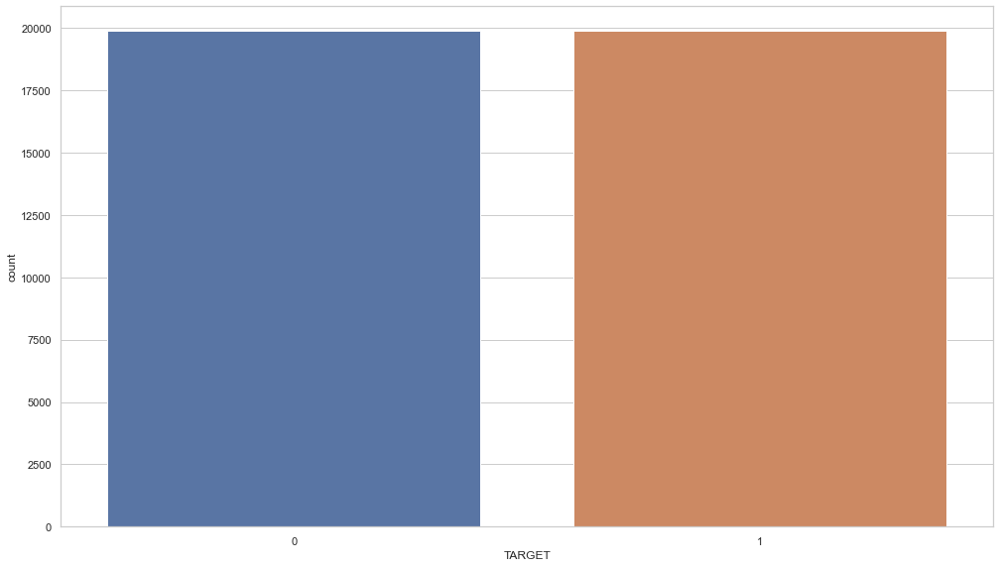

In [171]:
sns.set_theme(style="whitegrid")
plt.figure(figsize = (15, 9))
sns.countplot(x='TARGET', data=under_sample)

In [172]:
under_sample["EMERGENCYSTATE_MODE_No"].unique()

array([1., 0.])

In [173]:
# Drop the target from the training data
if 'TARGET' in under_sample:
    train_X = under_sample.drop(columns = ['TARGET'])
else:
    train_X = under_sample.copy()
    
train_y = under_sample.loc[:,'TARGET']

In [174]:
import xgboost as xgb

# Make the model with the specified regularization parameter
xgb_cl_undersampling = xgb.XGBClassifier()

params = {'learning_rate': list([0.1,0.4,0.7,1.0])}

clf = GridSearchCV(xgb_cl_undersampling, params, cv = 5, scoring=F_Beta)
clf.fit(train_X, train_y)

print(clf.best_params_)
print(clf.best_score_)

[23:44:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:44:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:44:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[23:45:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

In [175]:
xgb_cl_undersampling = clf.best_estimator_
yhat = xgb_cl_undersampling.predict(test_X)

In [176]:
test_X.head()

,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGA

In [177]:
yhat

array([1, 1, 0, ..., 0, 1, 1], dtype=int64)

In [178]:
train_X.head(10)

,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGA

In [179]:
len(train_X.columns)

242

In [180]:
len(test_X.loc[49103])

242

In [181]:
generate_model_report_Beta_3(test_y, yhat)

Accuracy =  0.688860705981822
Precision =  0.16045008379219536
Recall =  0.6765596608116293
F1 Score =  0.25938540134685345
FB Score (Beta = 3) =  0.5119000336072836


In [182]:
cm = pd.crosstab(test_y,yhat)

#reorder columns
cm = cm.reindex([1, 0], axis="columns")
#reorder rows
cm = cm.reindex([1, 0])

cm

col_0,1,0
TARGET,,
1,3351,1602
0,17534,39016


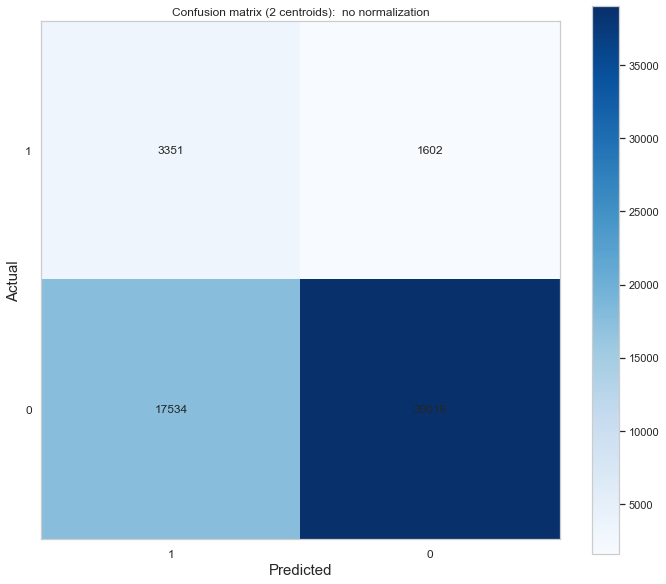

In [183]:
def plot_confusion_matrix(cm, title='Confusion matrix', cmap='Blues', normalize=False):
    
    # Adjust the size of the plot area ()
    plt.figure(figsize=(20, 20))

    # Show the plot
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    
    for (i, j), z in np.ndenumerate(cm):
        plt.text(j, i, z, ha='center', va='center')

    # Give the plot a title and colorbar legend
    plt.title(title, size=12)
    plt.colorbar()

    # All thes stuff for the tick mark labels
    xtick_marks = np.arange(len(cm.columns))
    ytick_marks = np.arange(len(cm.index))
    plt.xticks(xtick_marks, cm.columns, size=12)
    plt.yticks(ytick_marks, cm.index, size=12)

#     # Just the regular xlabel and ylabel for plot
#     plt.ylabel(cm.index.name, size=12)
#     plt.xlabel(cm.columns.name, size=12)
    
    plt.ylabel('Actual', size=15)
    plt.xlabel('Predicted', size=15)

    # Setting to offset the labels with some space so they show up
    plt.subplots_adjust(left = 0.5, bottom=0.5)
    
#     plt.grid(which='major', color='w', linestyle='-', linewidth=0)
#     plt.grid(which='minor', color='red', linestyle='-', linewidth=2)
    
    plt.grid(axis = 'x', color='w', linestyle='-', linewidth=0)
    plt.grid(axis = 'y', color='w', linestyle='-', linewidth=0)


# Plot the confusion matrix DataFrame

plot_confusion_matrix(cm,  title='Confusion matrix (%d centroids):  no normalization' % len(cm.columns))

plt.show()

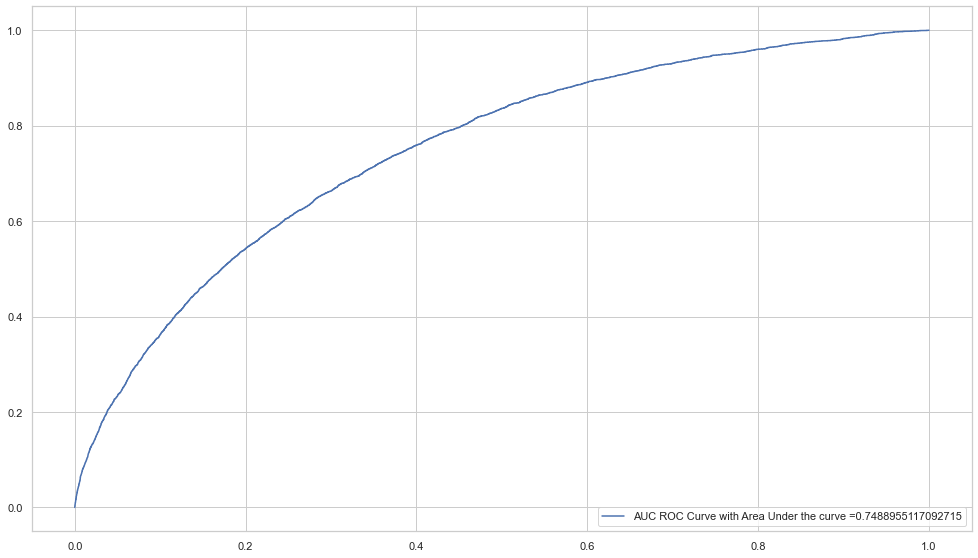

In [184]:
plt.figure(figsize = (15, 9))
def generate_auc_roc_curve(clf, X_test):
    y_pred_proba = clf.predict_proba(X_test)[:, 1]
    fpr, tpr, thresholds = roc_curve(test_y,  y_pred_proba)
    auc = roc_auc_score(test_y, y_pred_proba)
    plt.plot(fpr,tpr,label="AUC ROC Curve with Area Under the curve ="+str(auc))
    plt.legend(loc=4)
    plt.show()
    pass

generate_auc_roc_curve(xgb_cl_undersampling, test_X)

### Interpreting the best model (XGBoost Classifier, UNDERSAMPLING)

In [185]:
a = list(df2.columns)
a.remove('TARGET')
a

['NAME_CONTRACT_TYPE',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_AVG',
 'YEARS_BUILD_AVG',
 'COMMONAREA_AVG',
 'ELEVATORS_AVG',
 'ENTRANCES_AVG',
 'FLOORSMAX_AVG',
 'FLOORSMIN_AVG',
 'LANDAREA_AVG',
 'LIVINGAPARTMENTS_AVG',
 'LIVINGAREA_AVG',
 'NONLIVINGAPARTMENTS_AVG',
 'NONLIVINGAREA_AVG'

In [186]:
train = pd.DataFrame(train)
train.columns = a
train.head()

,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGA

In [187]:
len(train)

307511

#### SHAP Value

In [220]:
import shap # v0.39.0

explainer = shap.TreeExplainer(xgb_cl_undersampling, model_output='probability', feature_dependence='independent', data=test_X)
shap_values = explainer(test_X)

100%|===================| 61360/61503 [03:26<00:00]        

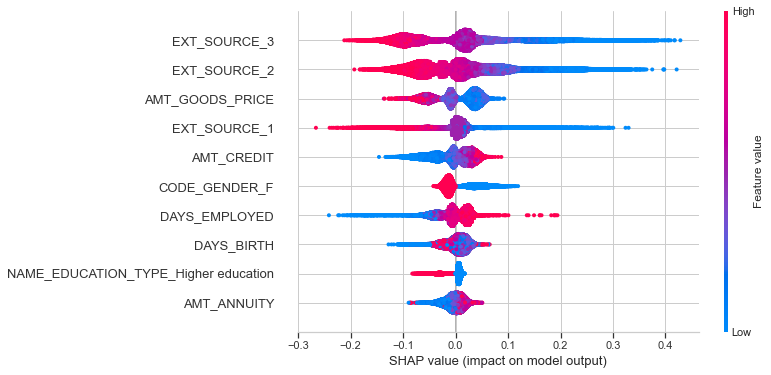

In [221]:
shap.summary_plot(shap_values,test_X,max_display=10)

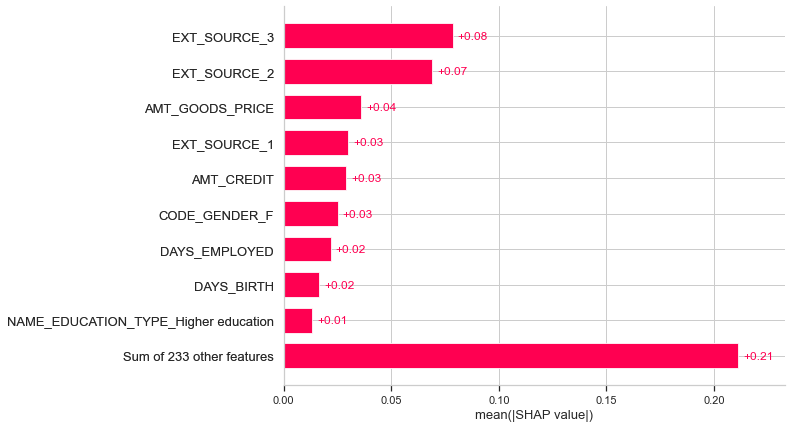

In [222]:
shap.plots.bar(shap_values,max_display=10)

In [247]:
ID = pd.DataFrame(app_train.loc[test_X.index,"SK_ID_CURR"])
ID.head(30)

,SK_ID_CURR
49103,156852
96031,211489
300915,448618
260145,401051
99054,215007
8425,109816
225295,360959
102543,219037
22798,126529
119712,238817


In [254]:
len(ID)

61503

In [255]:
len(test_X)

61503

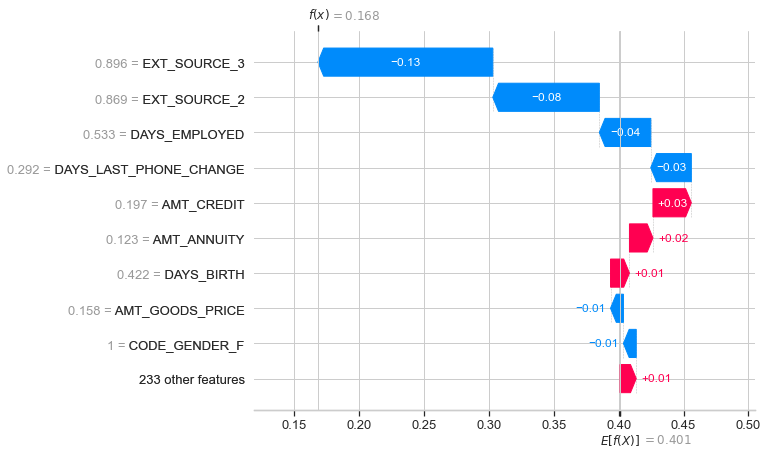

In [248]:
shap.plots.waterfall(shap_values[np.asscalar(ID.loc[ID['SK_ID_CURR']==156852].index)])

In [265]:
shap_values

.values =
array([[ 9.16638886e-03, -1.37312320e-02, -2.04035007e-03, ...,
         2.52461887e-03,  0.00000000e+00,  0.00000000e+00],
       [ 1.17153530e-02, -2.02459564e-02, -2.61317747e-04, ...,
         1.08253916e-03,  0.00000000e+00,  0.00000000e+00],
       [ 8.34408929e-03,  5.46855507e-03, -1.92933643e-05, ...,
        -2.35490491e-03,  0.00000000e+00,  0.00000000e+00],
       ...,
       [ 8.01365921e-03, -3.30208223e-02, -1.73474492e-04, ...,
         1.91892188e-03,  0.00000000e+00,  0.00000000e+00],
       [ 6.25891221e-03,  1.82816965e-02, -1.34750039e-04, ...,
         2.32008309e-03,  0.00000000e+00,  0.00000000e+00],
       [ 6.12116594e-03,  8.38580353e-03,  5.87198730e-04, ...,
         2.49397755e-03,  0.00000000e+00,  0.00000000e+00]])

.base_values =
array([0.40110764, 0.40110764, 0.40110764, ..., 0.40110764, 0.40110764,
       0.40110764])

.data =
array([[0., 1., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 1., 0., 1.],
  

In [225]:
xgb_cl_undersampling.predict(train)[0]

1

In [249]:
xgb_cl_undersampling.predict(train)[np.asscalar(ID.loc[ID['SK_ID_CURR']==156852].index)]

1

In [250]:
xgb_cl_undersampling.predict(train.loc[train.index==np.asscalar(ID.loc[ID['SK_ID_CURR']==156852].index),:]).item()

1

In [252]:
xgb_cl_undersampling.predict(test_X.loc[test_X.index==np.asscalar(ID.loc[ID['SK_ID_CURR']==156852].index),:]).item()

1

In [253]:
test_y[np.asscalar(ID.loc[ID['SK_ID_CURR']==156852].index)]

0

In [251]:
train_target[np.asscalar(ID.loc[ID['SK_ID_CURR']==156852].index)]

0

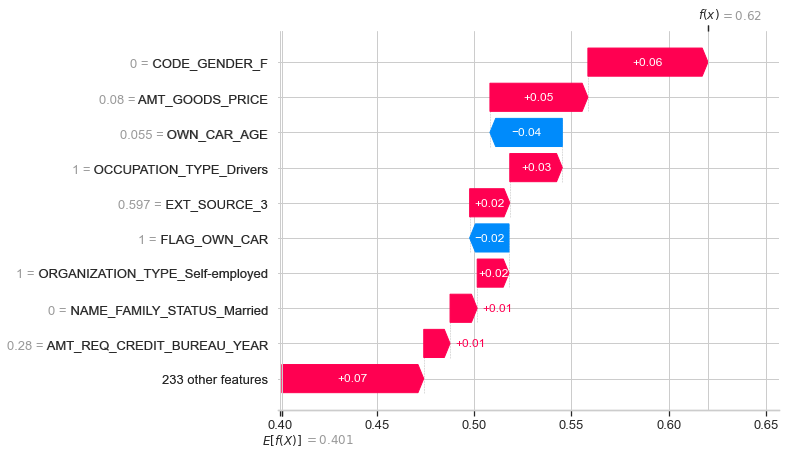

In [229]:
shap.plots.waterfall(shap_values[np.asscalar(ID.loc[ID['SK_ID_CURR']==100003].index)])

In [230]:
xgb_cl_undersampling.predict(train.loc[train.index==np.asscalar(ID.loc[ID['SK_ID_CURR']==100003].index),:]).item()

0

In [231]:
train_target[np.asscalar(ID.loc[ID['SK_ID_CURR']==100003].index)]

0

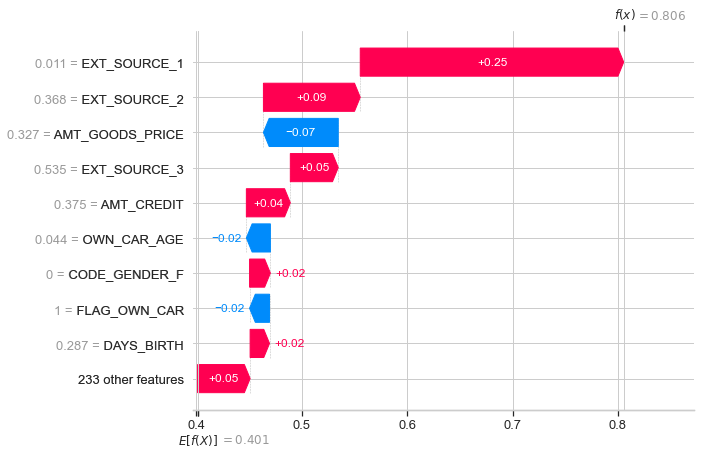

In [232]:
shap.plots.waterfall(shap_values[np.asscalar(ID.loc[ID['SK_ID_CURR']==100031].index)])

In [233]:
xgb_cl_undersampling.predict(train.loc[train.index==np.asscalar(ID.loc[ID['SK_ID_CURR']==100031].index),:]).item()

1

In [234]:
train_target[np.asscalar(ID.loc[ID['SK_ID_CURR']==100031].index)]

1

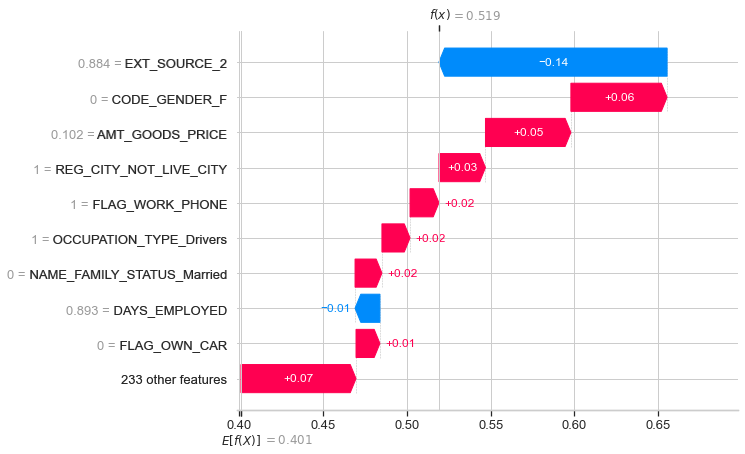

In [235]:
shap.plots.waterfall(shap_values[np.asscalar(ID.loc[ID['SK_ID_CURR']==130812].index)])

In [236]:
xgb_cl_undersampling.predict(train.loc[train.index==np.asscalar(ID.loc[ID['SK_ID_CURR']==130812].index),:]).item()

0

In [237]:
train_target[np.asscalar(ID.loc[ID['SK_ID_CURR']==130812].index)]

1

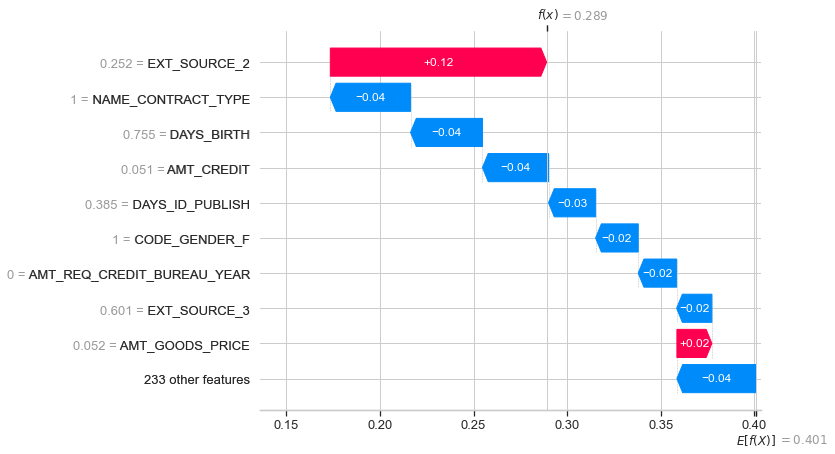

In [238]:
shap.plots.waterfall(shap_values[np.asscalar(ID.loc[ID['SK_ID_CURR']==129645].index)])

In [239]:
xgb_cl_undersampling.predict(train.loc[train.index==np.asscalar(ID.loc[ID['SK_ID_CURR']==129645].index),:]).item()

0

In [240]:
train_target[np.asscalar(ID.loc[ID['SK_ID_CURR']==129645].index)]

1

In [241]:
test_X.head()

,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGA

In [243]:
test_y.head()

49103     0
96031     0
300915    0
260145    0
99054     0
Name: TARGET, dtype: int64

In [246]:
app_train.loc[test_X.index,"SK_ID_CURR"].head()

49103     156852
96031     211489
300915    448618
260145    401051
99054     215007
Name: SK_ID_CURR, dtype: int64

#### LIME

In [210]:
from lime.lime_tabular import LimeTabularExplainer 
explainer = LimeTabularExplainer(train, 
                      feature_names=app_train.drop(columns = ['TARGET']).columns, 
                      class_names=[0, 1], 
                      discretize_continuous=False, 
                      verbose=True)

In [216]:
exp = explainer.explain_instance(train.loc[np.asscalar(ID.loc[ID['SK_ID_CURR']==100002].index)], xgb_cl_undersampling.predict_proba)
exp.show_in_notebook(show_table=True)

Intercept 0.38468434786506295
Prediction_local [0.91809307]
Right: 0.9235278


In [256]:
### Create a Pickle file using serialization 
import pickle
pickle_out = open("xgb_cl_undersampling.pkl","wb")
pickle.dump(xgb_cl_undersampling, pickle_out)
pickle_out.close()

In [258]:
test_X.to_csv("test_X.csv")

In [257]:
ID.to_csv("ID.csv")

In [288]:
len(data_1)

61503

In [289]:
len(data_2)

61503

In [282]:
data_1 = pd.read_csv('test_X.csv')
data_1 = data_1.drop(["Unnamed: 0"], axis=1)
data_1.head()

,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGA

In [283]:
data_2 = pd.read_csv('ID.csv')
data_2 = data_2.drop(["Unnamed: 0"], axis=1)
data_2.head(30)

,SK_ID_CURR
0,156852
1,211489
2,448618
3,401051
4,215007
5,109816
6,360959
7,219037
8,126529
9,238817


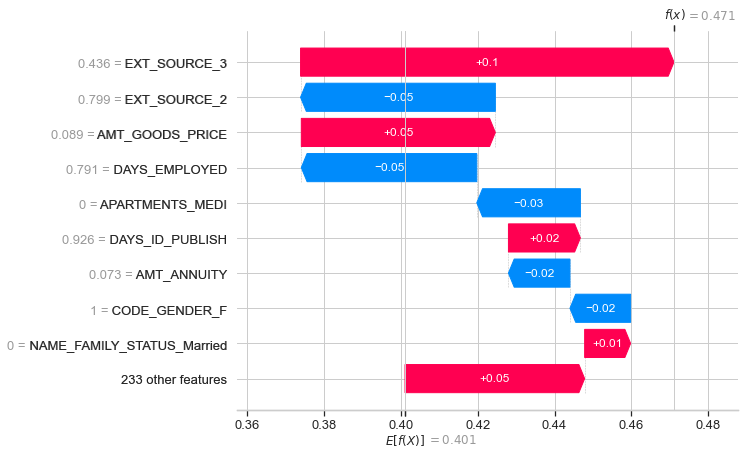

In [274]:
shap.plots.waterfall(shap_values[np.asscalar(data_2.loc[data_2['SK_ID_CURR']==278806].index)])

In [275]:
data_2.loc[data_2['SK_ID_CURR']==278806].index

Int64Index([20], dtype='int64')

In [279]:
test_y.head(21)

49103     0
96031     0
300915    0
260145    0
99054     0
8425      0
225295    0
102543    0
22798     0
119712    0
277778    0
194673    0
172634    0
110981    0
193292    0
13082     0
188353    0
6095      0
25061     0
236004    0
154281    1
Name: TARGET, dtype: int64

In [287]:
xgb_cl_undersampling.predict(data_1.loc[data_1.index==np.asscalar(data_2.loc[data_2['SK_ID_CURR']==278806].index),:]).item()

0

In [295]:
xgb_cl_undersampling.predict_proba(data_1.loc[data_1.index==np.asscalar(data_2.loc[data_2['SK_ID_CURR']==278806].index),:])[0][1]

0.47106516

In [281]:
data_1.head()

,Unnamed: 0,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity 

In [290]:
for i in data_2['SK_ID_CURR']:
    print(i)

156852
211489
448618
401051
215007
109816
360959
219037
126529
238817
421825
325728
300048
228748
324148
115247
318368
107126
129149
373361
278806
273123
349468
417957
396853
273492
435852
250884
329024
386571
357471
211381
396686
321550
352880
218674
320415
434473
128198
202662
203076
420639
419384
271857
123638
313772
443125
399873
234974
197847
301240
132769
434997
150326
178585
113671
243222
209503
410376
138199
428301
169265
125858
345426
239260
384795
238611
421071
378885
317233
400092
237138
394112
300017
280844
437232
280513
318466
267539
338147
236295
384012
368542
406788
127200
304149
422347
397292
443398
222006
408557
188138
449252
309412
151418
278928
375029
133357
226919
127023
220136
341143
307418
346577
420385
239984
161441
449931
105145
366097
160454
449348
311772
148521
298524
452873
307267
252222
223678
178326
275146
435225
148864
226998
401386
147434
259360
183117
439245
370063
308158
350967
231349
168931
112132
345919
225097
376291
357188
322925
417611
380214
390740

294993
415175
453779
203029
291390
403567
200297
268055
264126
379894
402423
246322
244338
271886
121914
447948
144273
337892
439014
401478
359893
400451
197446
115925
193800
392169
157180
331422
325444
406171
181066
290544
313132
246247
215313
256814
191802
163366
146871
389130
131133
431572
381240
243373
284653
286803
403625
231253
389431
449365
293174
430249
106073
164541
300245
176228
166835
293419
350217
299458
225017
420136
378130
239329
241552
395424
206166
327522
327061
209878
408502
133970
329299
389731
371660
142214
245077
365586
359938
424197
273098
451295
396136
419031
256451
174145
267703
238901
161680
207675
314213
315996
359364
385208
106834
103123
277748
124970
421790
235363
167897
371319
424243
139196
448754
453200
358518
282329
362551
406910
284765
276712
340697
149553
181519
191729
143352
271028
246292
376412
315206
352859
301609
455472
451279
110024
344672
285081
103177
358818
309622
212815
154985
247420
389781
321953
219143
327392
329415
446640
435000
263257
175610

267741
194915
423315
388540
263441
103444
297149
197860
350868
104283
444492
132130
379168
340147
124930
119652
348868
101146
423103
108700
221607
267491
216570
168222
428393
133303
149071
218875
132053
119572
276250
299259
262783
134029
321328
339267
117367
437917
120815
249978
365731
135173
123895
316892
289712
233628
129372
163232
386887
191793
360240
218410
121097
222172
215705
310256
356700
344715
340240
171743
229999
398158
136680
215089
417082
117246
259713
344259
249127
365305
356443
144676
445903
429987
327028
106909
360442
272356
338177
291476
280511
193661
323391
295854
180926
426984
453470
102396
256160
275914
333251
217208
137789
332506
253166
404823
445025
221569
168824
172410
281065
230262
243121
356574
238357
129259
209399
398928
302781
214469
420082
404541
101877
279244
189231
199066
188802
226915
294264
455744
171367
124385
349492
444547
379171
422981
313697
269648
385519
262691
244240
110346
306584
398013
239388
105628
390542
259015
132563
269659
126767
247073
196341

191856
290278
164111
250241
378843
158226
304568
449612
166938
304733
258278
195350
438027
195598
365967
397969
373964
344103
370592
240697
417551
269062
280474
285052
338782
234120
424750
441836
117143
390822
369875
260938
417133
439925
321537
319626
247643
181149
263108
105104
440206
335797
226141
331022
222914
231617
273303
272709
407815
218317
276740
238369
184791
138362
354331
292125
167407
120508
145879
341847
219291
381942
341159
142480
129273
173689
381931
424373
375435
420641
357431
349405
189183
213341
202528
398314
170762
426517
349382
184254
424345
434856
263191
200599
101432
285598
105846
263653
408061
179058
192123
101630
324588
325141
442508
453769
334149
355116
133756
426562
428900
415206
233415
426091
210154
346977
410271
223206
404019
106135
317931
207183
330751
228520
340441
347969
384439
439983
111310
123098
372086
289095
309247
285772
374373
128332
439993
376767
349801
154194
211661
450031
329214
305729
181343
303615
213380
334647
139102
440276
134047
208825
207034

352599
159098
123157
267473
175672
353889
112824
384685
366453
455794
103228
257078
421673
270057
427356
192744
358788
279161
186008
311433
303107
396103
301454
203857
343958
294689
430988
280559
401043
217880
288703
425882
189839
201940
234130
356398
169700
199503
309085
431960
349199
172444
234312
275729
452997
371298
242052
322697
234207
251903
167660
121561
131136
384162
131523
135337
278822
178767
133277
349563
305968
295902
364845
156790
361827
182202
206160
261184
283436
275175
234245
111745
446491
394747
148237
203494
167011
195521
443968
186974
118108
135094
212624
273751
388205
148501
300949
223950
184925
397440
362923
133618
226513
449767
384629
208388
155408
185742
269155
252008
361859
400139
378864
222882
249331
149651
275637
227840
327024
104331
258469
183706
353440
321292
216062
216639
421416
335390
129852
283946
197026
304471
212053
396219
197697
443277
105436
192339
392292
208068
151945
448841
298301
322190
365475
427351
263898
124620
218316
107317
148720
303462
356872

122619
362975
133440
192671
298530
125588
198667
411288
173682
231285
214275
253590
119237
414428
265122
122221
304280
383280
295252
399109
126128
193961
422501
357999
315353
128929
363320
319348
140321
305928
102285
143757
160525
261105
455710
360337
168072
315103
245046
348469
305092
253690
228112
304598
170267
425519
264325
410627
257390
239881
348286
326621
303528
237370
364789
360874
426979
122043
393386
349240
119768
226344
330620
245003
423345
194574
150403
209728
165974
213453
264625
405454
231482
279442
365747
302260
245096
446565
137237
375185
430829
145685
425106
373707
369868
283791
303138
442914
167088
341628
201827
276519
373398
304792
262668
161843
249419
435442
320696
344414
320606
447300
148168
218825
412701
263340
336489
141325
276462
419311
200950
269193
363936
116919
299452
204096
456129
321963
449369
315820
192581
112719
122988
302410
180477
364393
324031
313701
187239
169740
379528
337518
338399
322073
361188
189265
252978
331718
440034
170653
187399
304272
389861

386471
342468
304054
112762
406285
255302
295525
369476
101441
412109
263130
124835
391536
163755
164594
348196
406533
364857
312427
250630
425044
178554
331473
433547
362583
202813
376187
197407
203395
409464
178321
114101
135859
136532
187757
142253
386195
257811
208802
114531
106240
275156
226468
422293
163877
452835
220234
253775
244998
244861
185632
240541
416712
237924
167071
185018
226114
247850
389932
119964
105175
420987
441849
206234
259964
164657
175377
238002
360161
363070
386182
421050
286780
241877
206206
337708
182137
129256
301929
367544
338912
346658
455548
357331
451926
193250
180482
136882
350748
184088
168468
188118
401793
411544
258218
142208
346840
319696
114457
322048
112523
116314
250672
392823
399035
269729
101137
264383
248666
191285
326255
151115
384913
186518
316071
295699
257321
302485
124145
156591
225179
135154
421684
402189
221932
217985
159246
360261
190257
344899
302264
145460
146392
406733
201488
359543
303430
369762
272362
430137
100750
281885
423467

254938
200477
219264
438353
121550
111625
366261
237526
129891
405227
231063
130766
158398
111604
229519
316099
292919
413547
334057
368712
265427
250003
337184
334381
273076
314384
389186
121206
205850
155758
451625
280830
335734
220118
398627
266005
315243
153116
121299
300691
400761
257212
321684
123188
360005
267858
122220
387223
451712
359859
264174
262843
286628
393728
429845
333154
136131
377148
194788
102361
420566
136180
355883
413665
425701
142457
327077
102658
408160
339632
154641
248565
298976
385534
392244
193683
216879
429994
424182
120362
421668
434125
286827
407405
344851
101201
364033
237913
159983
359013
141907
450821
294647
418378
139968
162600
220719
405122
226649
363770
133585
281572
408891
160029
429842
125492
379896
190759
295951
184352
129691
100898
349238
365200
264418
112238
125836
238733
368439
209737
344932
442810
454591
312650
398253
381891
306519
443083
136868
168870
387018
142975
338408
277716
328502
303519
199271
110427
143786
177851
405579
382587
130793

135437
286728
277436
423385
413045
157536
350978
356212
106497
318907
103241
361034
120164
375979
174219
413612
139720
310179
125670
221269
264235
287689
253781
244138
268259
451032
295763
352912
418516
437318
233442
234359
434186
112991
382676
198474
248859
397657
349106
251062
120023
384832
382949
222160
198240
144528
167352
425003
372660
202517
394181
422903
245445
274773
171425
224470
224936
131927
438457
214752
351605
320065
327793
418326
240825
224656
222617
429827
144791
368413
410973
435396
285466
164047
212885
176794
114089
433102
360272
132915
441155
315219
220172
215562
117361
273105
121872
372551
338064
203906
162302
331661
449042
267688
341293
269774
434687
131732
251971
388105
161371
369389
241798
293394
108734
107855
204470
166199
292131
289509
382618
276946
365121
173174
157750
257707
320443
335442
286998
101409
449222
411221
246160
405826
380915
107629
314029
292827
163526
369562
199254
261542
220518
308202
348262
418574
320802
106966
161007
390434
123471
239590
268786

382617
149952
134087
416728
360156
101991
281478
334860
438043
307814
438671
387138
312002
162273
159484
377647
169623
407846
336572
317646
301803
191385
110564
271468
430351
268838
169396
258280
321022
350423
415971
350890
187275
441343
435332
301616
445740
112314
315496
114034
353283
434654
123324
400663
107791
394165
336205
105852
349701
131252
181848
160087
440220
349219
211248
173110
370949
410318
414974
385224
335376
231019
299971
311799
371399
420671
285957
236301
203895
240779
230197
188217
144113
383958
325107
413316
216661
400341
328656
328645
407286
249724
254893
280032
332909
108221
365583
262279
123431
271317
165100
154068
291573
373587
102355
292446
284149
215667
331059
131919
416141
133483
197672
395695
302611
279151
326336
401806
303559
302516
101560
257033
433100
184189
320971
219192
370975
244393
197706
425561
318339
427223
192023
214519
320294
193417
425908
324256
311594
124590
128388
178850
299059
121707
253212
439895
337271
446281
270232
374509
415434
192307
319690

178115
454446
359053
239192
193146
328625
274738
288527
255496
448226
453208
188370
266199
270671
325517
316730
166898
208702
131612
179564
402322
298351
388999
338814
216484
100865
105924
300480
183279
346123
242424
258404
130434
209020
285829
226451
102968
221340
295721
193829
184382
139791
391385
137553
113620
355564
399485
111608
342466
448741
442598
212867
163695
159219
303516
424481
359700
235585
310970
180654
164346
347434
347518
259705
167318
298247
281797
405890
163378
325048
133325
329436
355273
425672
321560
134001
196122
247398
325658
398364
304934
242761
313455
315994
153998
304648
423692
135463
344530
166422
415942
440254
244003
244816
302023
275939
224229
436202
434344
326677
346947
249972
273504
249571
321653
203734
123961
116475
383472
141077
272834
365783
416570
152223
291064
300362
454921
305366
148998
311047
312285
166259
443217
295981
102366
444214
380184
157929
249807
266306
267973
379608
382638
432195
327294
305581
222746
324394
124630
168711
203157
311538
129846

359120
202065
194169
208503
383291
317897
250942
352170
451618
239443
359117
317992
234961
227211
142201
256415
355690
139360
182578
409170
292932
346467
363293
347397
347681
453334
189827
325456
325498
285132
305899
409474
202286
260576
288293
189533
205948
244886
183965
419033
234376
437603
212370
448172
364530
129623
265056
189012
418170
450212
149306
328853
232411
430031
178999
314865
418741
169574
450348
156122
397844
396317
368841
291078
288387
159784
131256
366472
132000
445267
372543
319223
358527
283121
149760
281766
404162
325281
229826
304586
110799
233445
162695
344757
215802
281353
437860
294360
202541
115756
267964
260090
116205
230556
263337
426589
322635
170690
305701
128192
278444
392385
261117
393990
111087
296395
427415
195029
138825
266434
168705
368902
206888
387495
144039
385829
262700
368647
400592
264333
181286
372552
192966
400340
140653
353628
256481
275952
401422
321855
440467
327747
263840
297829
150567
128271
348808
348846
153967
129736
112871
367718
139584

211202
445694
276657
196639
249335
222716
155972
297223
359904
242347
349208
305747
222913
288748
266270
255281
217989
383545
410404
119669
438722
190047
260166
255893
100320
343892
393026
438390
441505
244065
343825
192778
267646
447750
224183
311881
304624
344255
268126
422691
382404
348674
448003
247683
293594
411606
284534
143635
296697
345665
147737
289270
394272
408371
319255
249827
164915
182246
107320
368958
264987
208781
410863
422882
156312
332283
134476
246114
149975
368470
304453
324951
332758
452179
182728
350391
265721
121747
274817
172924
247300
247035
176415
151681
129644
128818
283985
377854
292528
441158
239826
356225
401055
367063
293069
243668
298306
256229
229249
155694
382543
421083
338357
255904
131573
341773
311347
181240
144823
184684
161426
305780
257415
389677
291403
433713
175176
103993
109601
393919
251776
418677
331195
418933
148304
154493
236533
220245
419891
302224
231073
176311
160126
251788
323158
375126
203208
104204
393037
294122
233684
157887
165122

138115
245610
301752
306719
172343
353027
189011
114028
419717
107383
262981
324077
318328
329238
134912
308209
186352
342731
313544
314181
227120
121702
336528
363590
319734
177947
165757
171532
367496
178145
106625
250722
254686
285986
104694
189073
363909
169930
138113
278019
166429
421362
226340
202722
310492
133534
250159
146993
386315
129819
450924
172559
258463
239975
323129
297612
116985
444630
263515
132385
397896
168226
376006
355459
245158
224526
127485
225856
232939
244625
376946
262683
137410
426249
227690
309708
427794
295967
162331
338313
449453
316577
427857
104838
327274
122616
208348
370364
334026
147976
137440
142891
192687
126322
354046
183980
121519
339206
159057
141056
192787
320863
132778
125634
167315
351493
222039
402842
338823
349481
212486
424393
317034
222592
211691
410750
357672
173517
161870
354189
342577
265689
436061
232903
453634
342719
339848
292322
263026
373558
189575
350824
123487
343809
447454
325091
419528
166301
170531
211101
271079
380240
231934

190060
235936
252593
110357
233288
310494
151447
236390
274270
305536
101266
396534
446651
363030
397053
336768
330344
188357
266673
223328
419108
361816
272077
337966
446510
264180
120171
155354
444503
291151
272550
271629
373141
324940
260413
356647
227417
344647
217813
271678
374807
348045
175263
179370
100794
309760
441752
347307
214055
297616
340696
150504
450538
186476
293764
246750
178092
393188
276618
437436
364598
365187
111985
346084
128771
234944
368020
421494
184785
287646
379350
304238
247651
158593
230386
150717
106788
205223
355552
376545
381300
350482
421294
305833
249243
212832
296844
434860
321628
433217
208867
315532
278652
107374
119170
415332
217019
387444
235257
284515
227817
208813
184895
140975
120234
396241
448823
377026
153651
437806
199481
209856
194062
106328
193630
398405
415990
153409
213777
322676
200850
201152
435712
306521
129226
238785
132313
434979
292743
436372
123409
147036
337283
326549
166969
336782
299838
405514
203790
445696
152955
233457
447216

153300
259598
451509
318489
269463
236004
226765
452475
228275
416135
442856
431536
279812
217731
448287
293310
170093
278789
279514
194154
305834
341904
427107
261342
445477
401401
389720
116378
116810
384744
409567
109045
269368
287583
264658
352207
298079
384922
440412
246581
288522
338031
113281
305279
402564
143755
434443
129100
270205
123158
287413
261816
264031
394031
384031
420503
425676
415423
430745
385220
313393
142843
415379
145182
284703
121755
210096
101212
182900
349904
386346
183773
103573
170141
371569
130250
356471
308810
186362
203112
267181
190840
177695
341832
353645
211896
270964
379604
199111
209438
302409
367848
336667
259503
455163
408676
432336
291448
245634
235473
317442
128348
357264
411927
196020
387614
295764
195338
161849
196829
373730
366231
104024
345463
361907
430470
293946
319498
426499
338395
453058
111261
119051
440084
111986
317775
218189
432973
120578
324397
227907
128410
208208
291069
391580
381519
193631
370661
124340
428826
129979
374205
160259

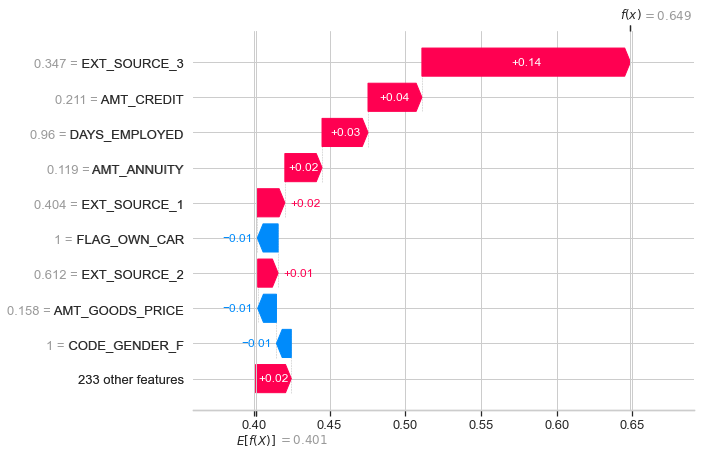

In [292]:
shap.plots.waterfall(shap_values[np.asscalar(data_2.loc[data_2['SK_ID_CURR']==156852].index)])

In [305]:
data_1.loc[range(100),]

,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGA

In [312]:
pd.DataFrame({'Type de contrat':app_train.loc[app_train.index==0,"NAME_CONTRACT_TYPE"],
           'Sexe':app_train.loc[app_train.index==0,"NAME_CONTRACT_TYPE"],
           'Montant des revenus':app_train.loc[app_train.index==0,"AMT_INCOME_TOTAL"],
           'Montant du crédit':app_train.loc[app_train.index==0,"AMT_CREDIT"]}).transpose()

,0
Type de contrat,0.0
Sexe,0.0
Montant des revenus,202500.0
Montant du crédit,406597.5


In [316]:
test_X.loc[test_X.index==np.asscalar(ID.loc[ID['SK_ID_CURR']==156852].index),"NAME_CONTRACT_TYPE"]

49103    0.0
Name: NAME_CONTRACT_TYPE, dtype: float64